In [16]:
from compression.tcm import TCM
from compression.util import (compress_image, decompress_image, pad, crop, compute_psnr, compute_msssim, compute_bpp)
import matplotlib.pyplot as plt
from src.video_util import (frame_to_video, get_fps, get_frame_count, prepare_frames)
from PIL import Image
import numpy as np

In [17]:
def Eval_res2(checkpoint_path, N, res_tensor, device):
    p = 128
    res_tensor = res_tensor.to(device)
    net = TCM(config=[2, 2, 2, 2, 2, 2], head_dim=[8, 16, 32, 32, 16, 8], drop_path_rate=0.0, N=N, M=320)
    net = net.to(device)

    op6 = []
    net.eval()
    dictory = {}

    if checkpoint_path:  # load from previous checkpoint
        print("Loading", checkpoint_path)
        checkpoint = torch.load(checkpoint_path, map_location=device)
        for k, v in checkpoint["state_dict"].items():
            dictory[k.replace("module.", "")] = v
        net.load_state_dict(dictory)

    psnr = []
    bitR = []
    mssim = []
    time_ = []
    net.update()
    print(res_tensor.shape)

    for i in range(res_tensor.shape[0]):
        Stmp2 = res_tensor[i].unsqueeze(0)
        x = Stmp2.float().to(device)
        print(x.shape)

        x_padded, padding = pad(x, p)
        print(x_padded.shape)
        # Compress
        out_enc, compression_time = compress_image(net, x_padded, device)

        # Decompress
        out_dec, decompression_time = decompress_image(net, out_enc, padding, device)

        num_pixels = x.size(0) * x.size(2) * x.size(3)

        # resized_tensor2 = torch.nn.functional.interpolate(x, size=(200, 200), mode='bilinear')
        totalBits = sum(len(s[0]) for s in out_enc["strings"]) * 8.0
        tmp0 = sum(len(s[0]) for s in out_enc["strings"]) * 8.0 / num_pixels
        tmp1 = compute_msssim(x, out_dec["x_hat"])
        tmp2 = compute_psnr(x, out_dec["x_hat"])

        print(f'Time: {compression_time + decompression_time:.2f}s')
        print(f'Bitrate: {tmp0:.3f}bpp')
        print(f'MS-SSIM: {tmp1:.2f}dB')
        print(f'PSNR: {tmp2:.2f}dB')
        
        
        bitR.append(totalBits)
        mssim.append(tmp2)
        psnr.append(tmp1)
        time_.append(compression_time + decompression_time)

        print("Decompressed Image")
        compressed_im = out_dec["x_hat"][0]
        op6.append(compressed_im)
        plt.imshow(compressed_im[0].cpu(), cmap="gray")
        plt.show()

    return torch.stack(op6), bitR


In [18]:
import torch
import cv2
import mediapy as media
import os

# Load the video
video_path = "result/pexels-koolshooters-7322716/key.mp4"  # Replace with your video path
cap = cv2.VideoCapture(video_path)

# Check if the video is opened successfully
if not cap.isOpened():
    raise ValueError("Error opening video file. Please check the path.")

# Extract frames and convert them to tensors
frames = []
while True:
    ret, frame = cap.read()
    if not ret:
        break
    # Convert frame from BGR to RGB (as OpenCV uses BGR format by default)
    frame_rgb = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    # Convert frame to tensor and append
    frame_tensor = torch.tensor(frame_rgb, dtype=torch.float32).permute(2, 0, 1)  # HWC -> CHW
    frames.append(frame_tensor)

cap.release()
video_tensor = torch.stack(frames)  # Shape: (Num_Frames, Channels, Height, Width)

# Check the shape of the stacked tensor
print("Key Frames:", video_tensor.shape)
# Plotting frames using mediapy
# media.show_images([frame.permute(1, 2, 0).numpy().astype('uint8') for frame in frames[:10]], columns=5)  # Display first 10 frames
# media.show_images(video_tensor)

Key Frames: torch.Size([23, 3, 384, 512])



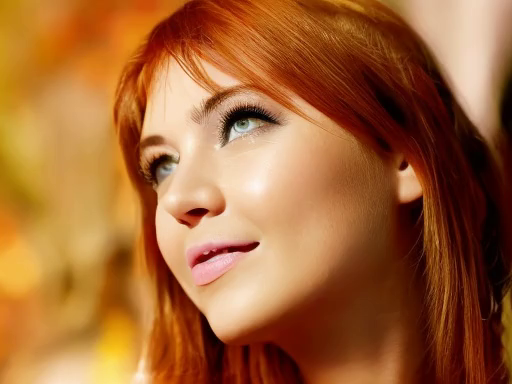
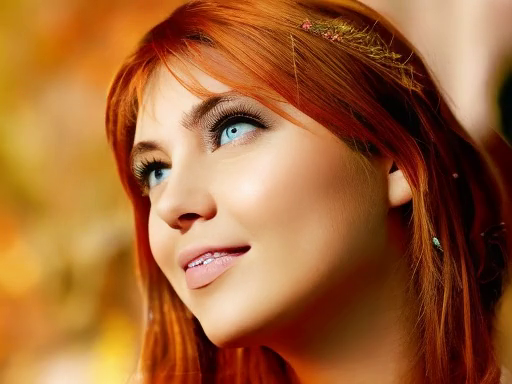
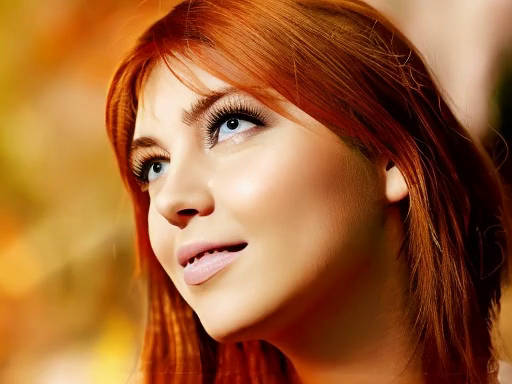
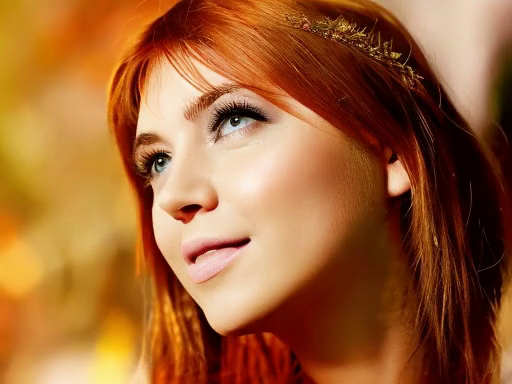
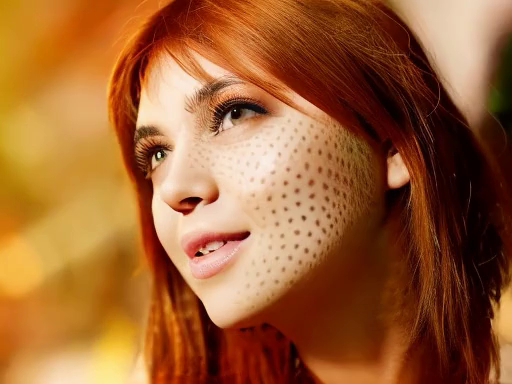
...
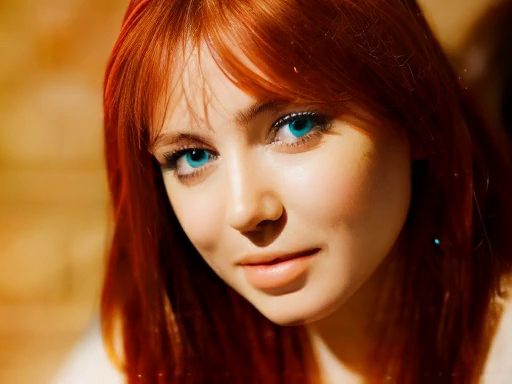
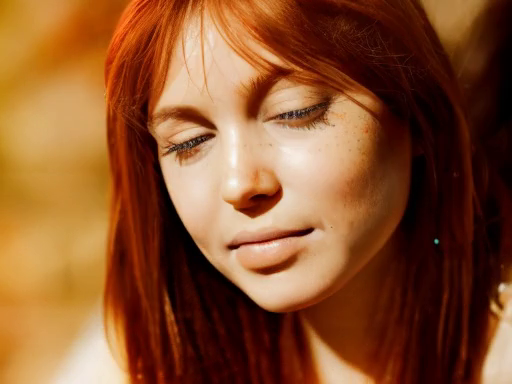
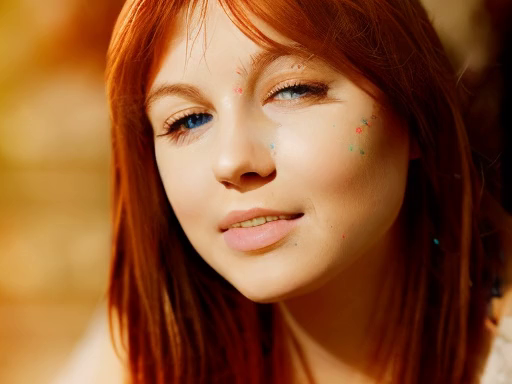
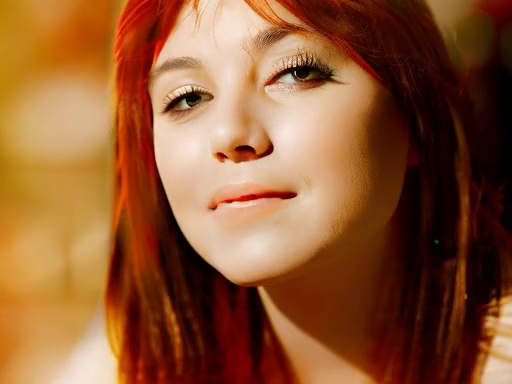
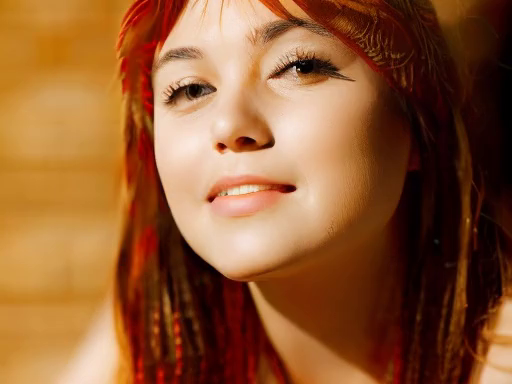

In [5]:

# Plotting frames using mediapy
media.show_images([frame.permute(1, 2, 0).numpy().astype('uint8') for frame in video_tensor], columns=5)  # Display first 10 frames


In [6]:
print("Key Frames shape:", video_tensor.shape)
print("Key Frames max:", video_tensor.max())
print("Key Frames min:", video_tensor.min())

Key Frames shape: torch.Size([23, 3, 384, 512])
Key Frames max: tensor(255.)
Key Frames min: tensor(0.)


In [7]:
video_tensor1 = video_tensor/255.0

In [8]:
print("Key Frames shape:", video_tensor1.shape)
print("Key Frames max:", video_tensor1.max())
print("Key Frames min:", video_tensor1.min())

Key Frames shape: torch.Size([23, 3, 384, 512])
Key Frames max: tensor(1.)
Key Frames min: tensor(0.)


## Compression LAmbda = 0.0025

Loading /home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.0025.pth.tar
torch.Size([23, 3, 384, 512])
torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.62s
Bitrate: 0.066bpp
MS-SSIM: 15.52dB
PSNR: 33.22dB
Decompressed Image


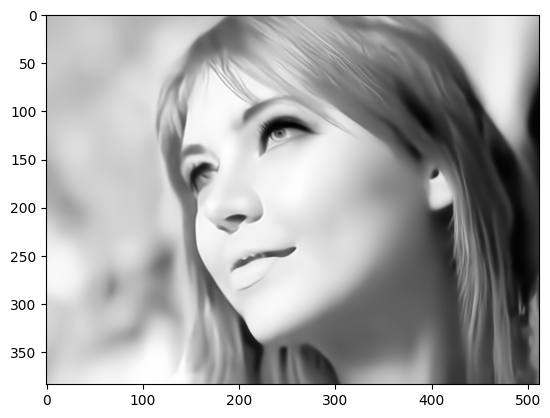

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.61s
Bitrate: 0.085bpp
MS-SSIM: 15.29dB
PSNR: 32.10dB
Decompressed Image


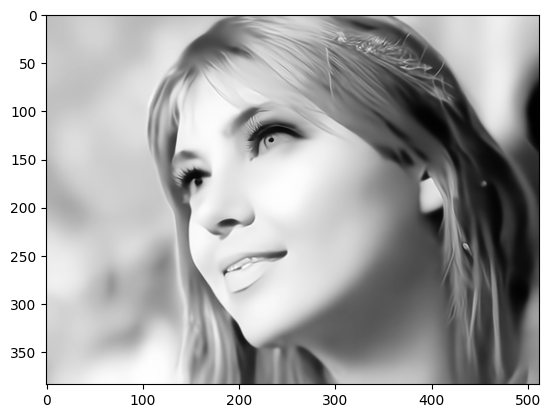

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.087bpp
MS-SSIM: 14.92dB
PSNR: 31.92dB
Decompressed Image


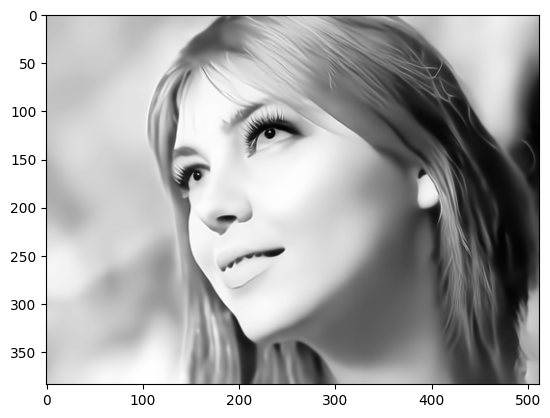

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.093bpp
MS-SSIM: 15.33dB
PSNR: 32.05dB
Decompressed Image


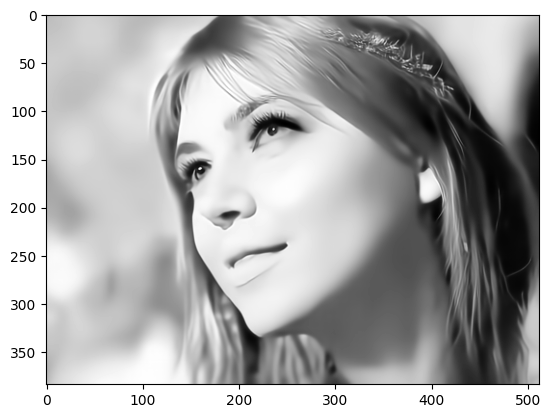

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.65s
Bitrate: 0.086bpp
MS-SSIM: 14.41dB
PSNR: 32.04dB
Decompressed Image


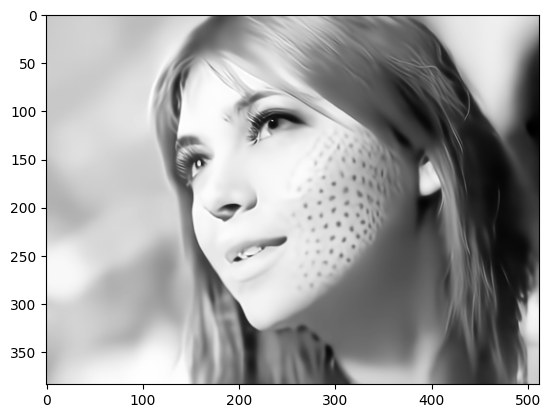

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.62s
Bitrate: 0.086bpp
MS-SSIM: 15.05dB
PSNR: 31.98dB
Decompressed Image


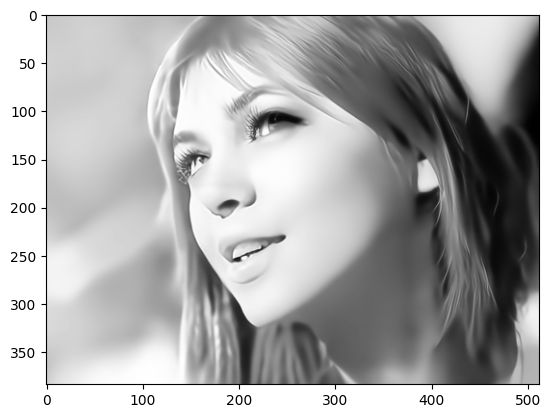

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.61s
Bitrate: 0.090bpp
MS-SSIM: 14.62dB
PSNR: 31.95dB
Decompressed Image


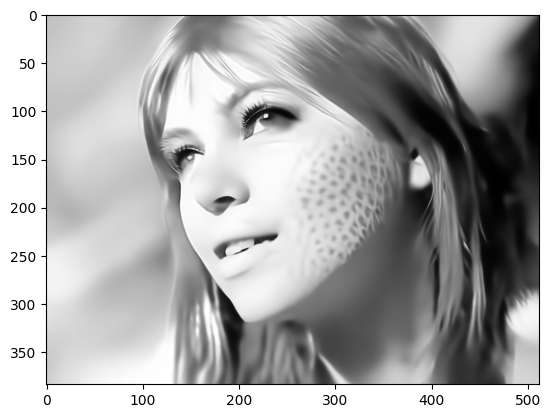

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.62s
Bitrate: 0.087bpp
MS-SSIM: 14.74dB
PSNR: 31.83dB
Decompressed Image


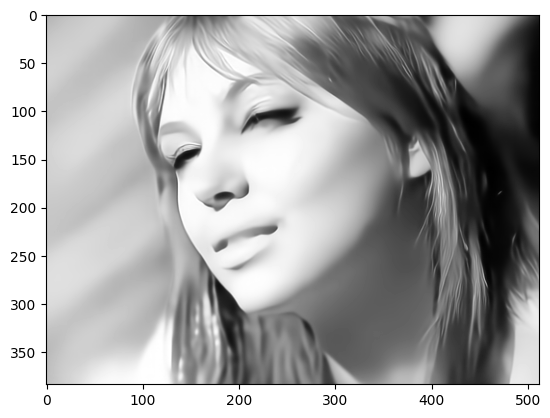

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.68s
Bitrate: 0.066bpp
MS-SSIM: 14.86dB
PSNR: 33.28dB
Decompressed Image


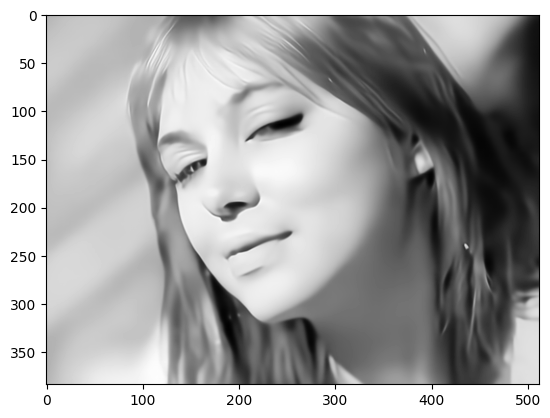

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.076bpp
MS-SSIM: 15.28dB
PSNR: 33.10dB
Decompressed Image


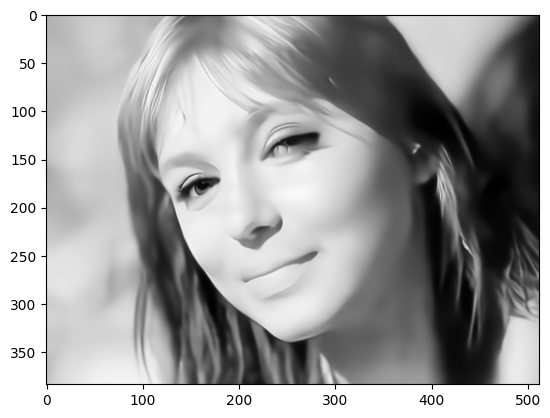

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.60s
Bitrate: 0.072bpp
MS-SSIM: 15.17dB
PSNR: 33.22dB
Decompressed Image


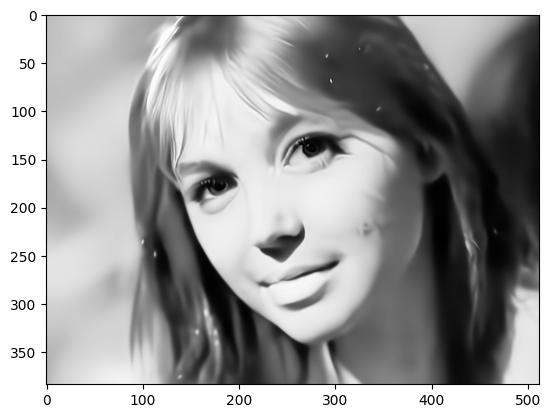

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.073bpp
MS-SSIM: 14.81dB
PSNR: 32.91dB
Decompressed Image


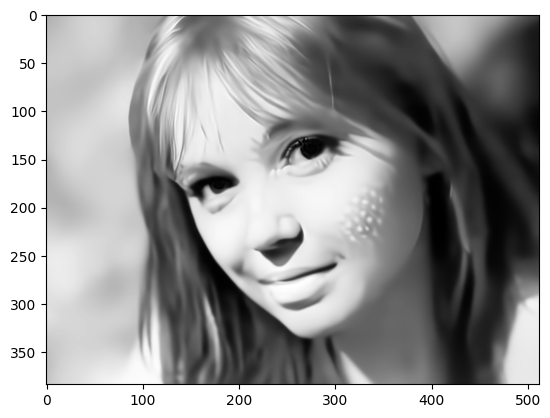

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.68s
Bitrate: 0.067bpp
MS-SSIM: 15.65dB
PSNR: 33.36dB
Decompressed Image


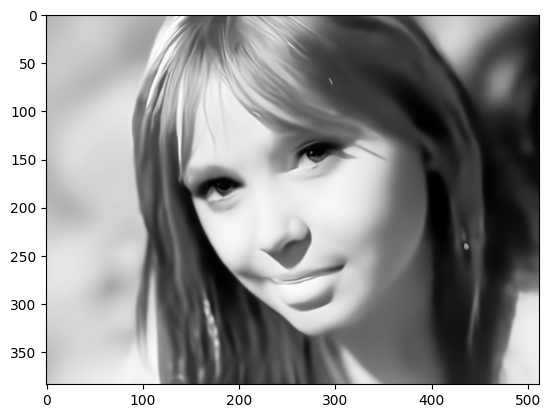

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.066bpp
MS-SSIM: 15.34dB
PSNR: 33.38dB
Decompressed Image


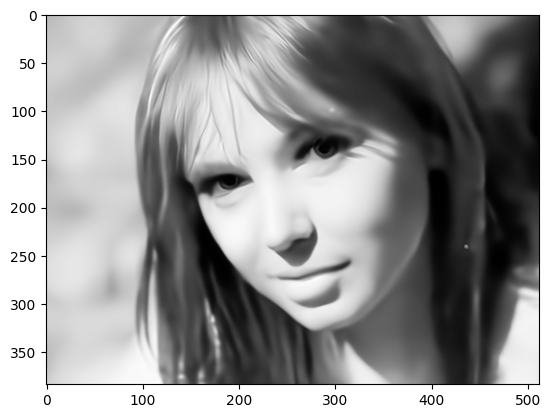

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.061bpp
MS-SSIM: 15.25dB
PSNR: 34.05dB
Decompressed Image


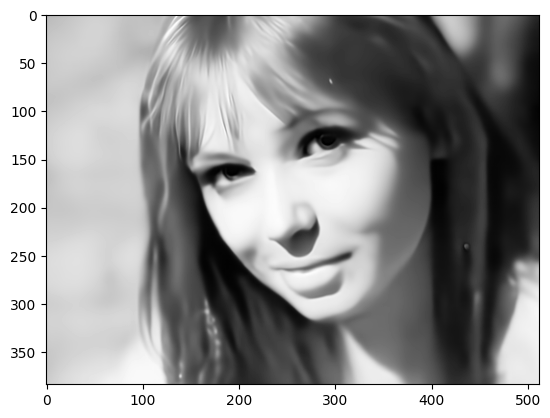

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.62s
Bitrate: 0.064bpp
MS-SSIM: 15.28dB
PSNR: 33.82dB
Decompressed Image


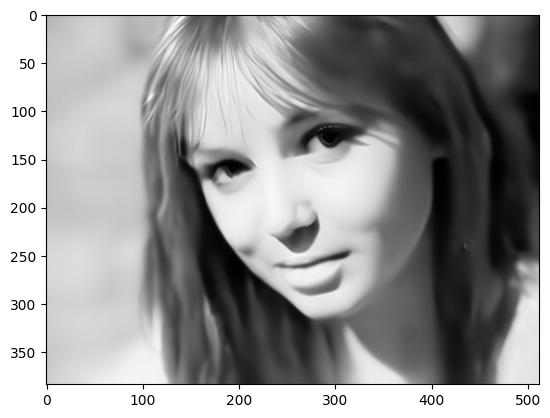

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.063bpp
MS-SSIM: 15.55dB
PSNR: 33.93dB
Decompressed Image


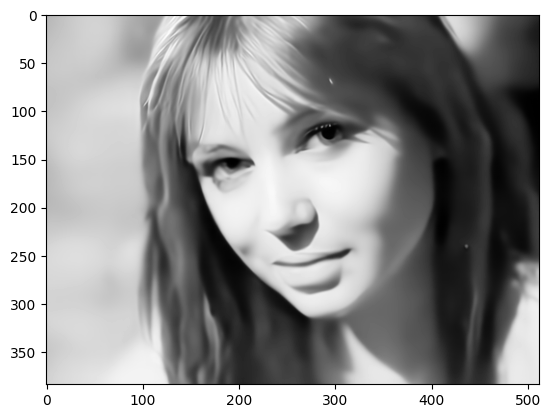

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.069bpp
MS-SSIM: 15.20dB
PSNR: 33.49dB
Decompressed Image


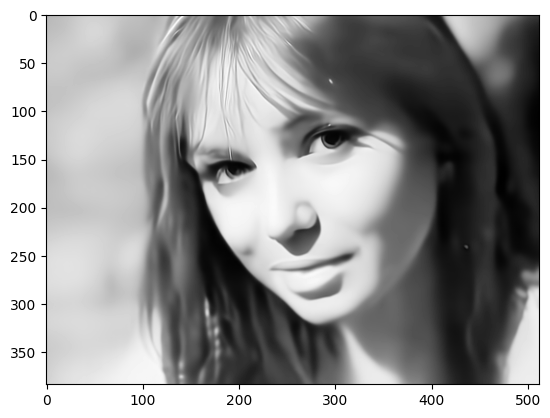

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.52s
Bitrate: 0.062bpp
MS-SSIM: 15.28dB
PSNR: 33.99dB
Decompressed Image


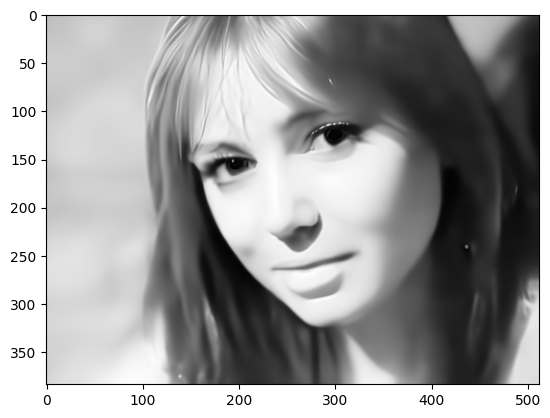

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.061bpp
MS-SSIM: 15.57dB
PSNR: 34.42dB
Decompressed Image


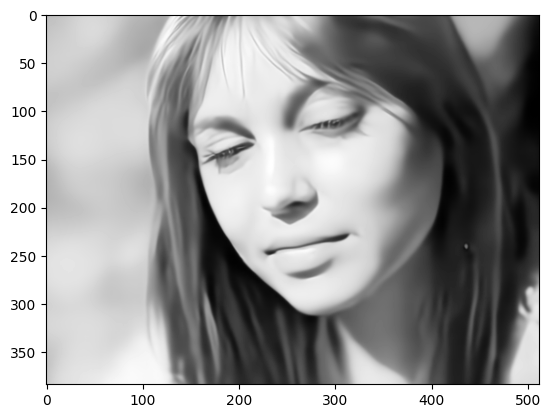

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.46s
Bitrate: 0.060bpp
MS-SSIM: 15.79dB
PSNR: 34.37dB
Decompressed Image


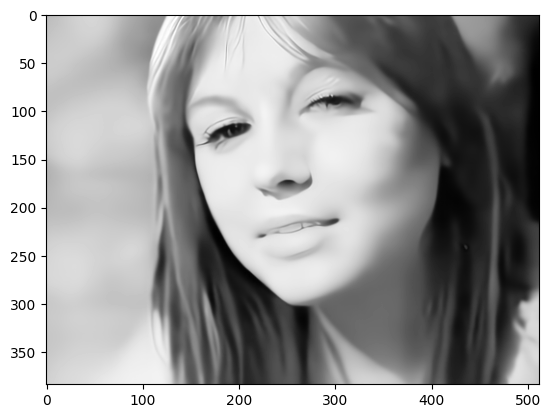

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.060bpp
MS-SSIM: 16.06dB
PSNR: 34.56dB
Decompressed Image


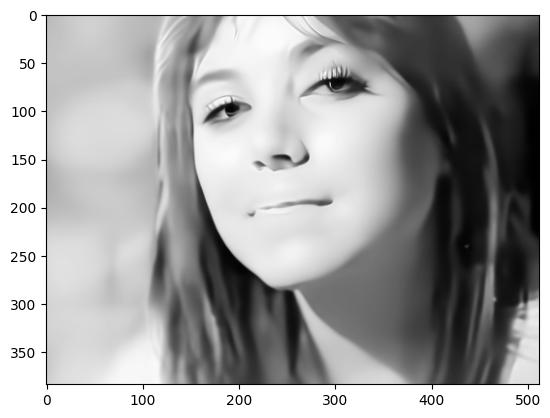

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.065bpp
MS-SSIM: 15.54dB
PSNR: 34.15dB
Decompressed Image


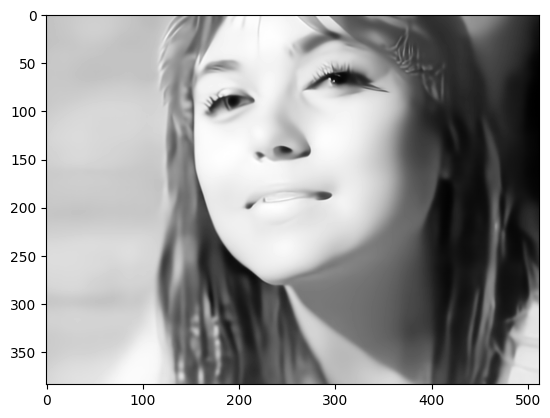

In [19]:
qp = 1
checkpoint_path = '/home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.0025.pth.tar'
Stmp2 = video_tensor1
# Stmp2 = res_tensor
device = 'cuda:1'
res_comp_L0p0025_N64, bitR_L0p0025_N64 = Eval_res2(checkpoint_path , 64, Stmp2, device)

key_dir = "result/pexels-koolshooters-7322716/keys_0p0025"
os.makedirs(key_dir, exist_ok=True)
numpy_array = res_comp_L0p0025_N64.cpu().detach().numpy()
# Assuming numpy_array has values in [0, 1] and shape (23, 3, 384, 512)
for i in range(numpy_array.shape[0]):
    # Rearrange axes from (3, 384, 512) to (384, 512, 3) for RGB
    img_array = np.transpose(numpy_array[i], (1, 2, 0))
    
    # Normalize values to [0, 255] and convert to uint8
    img_array = (img_array * 255).astype(np.uint8)
    
    # Save image
    idx = 10*i + 1
    Image.fromarray(img_array).save(os.path.join(key_dir, f'{idx:04d}.png'))

work_dir = "result/pexels-koolshooters-7322716/"
input_path = "result/pexels-koolshooters-7322716/key.mp4"
interval = 1
fps = get_fps(input_path)
fps //= interval
key_video_path = os.path.join(work_dir, 'key_0p0025.mp4')
frame_to_video(key_video_path, key_dir, fps, False)



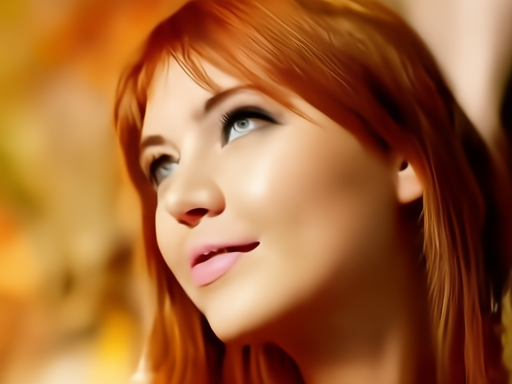
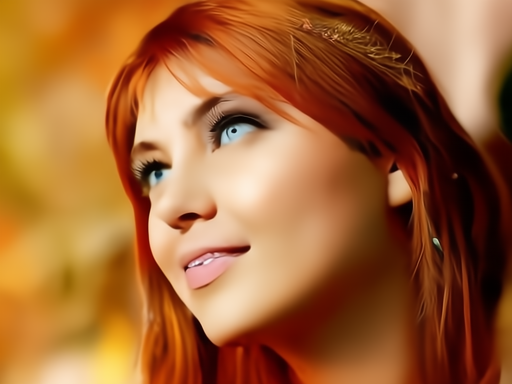
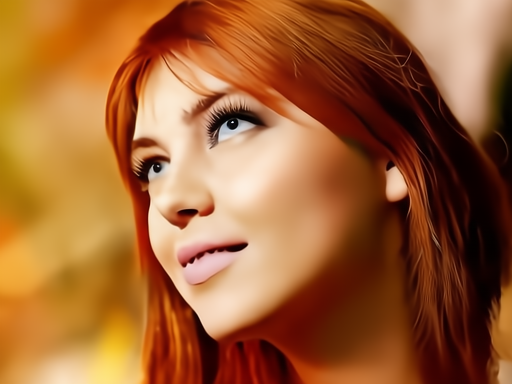
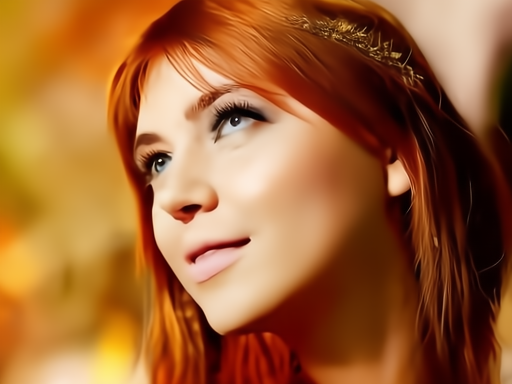
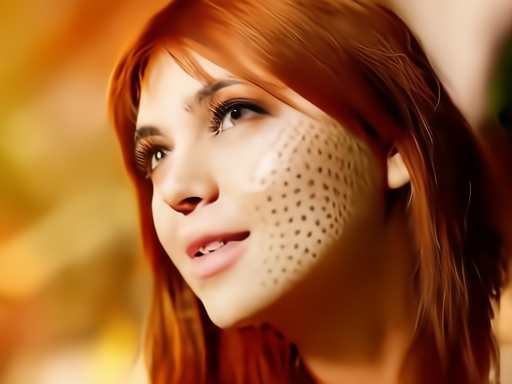
...
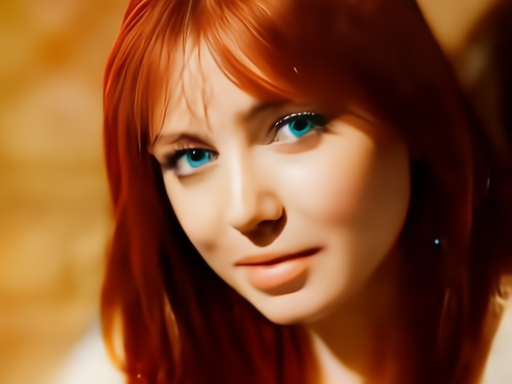
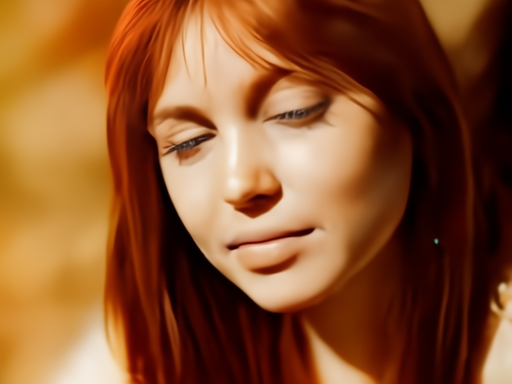
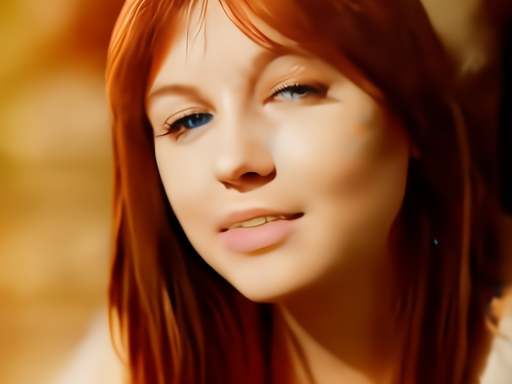
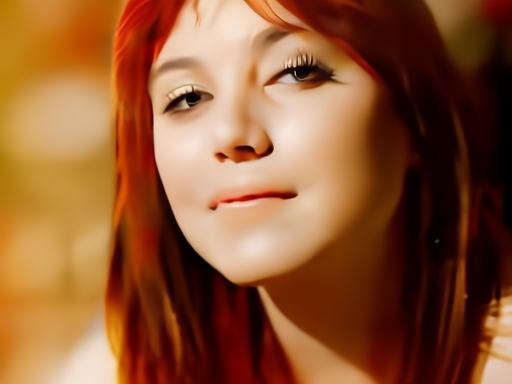
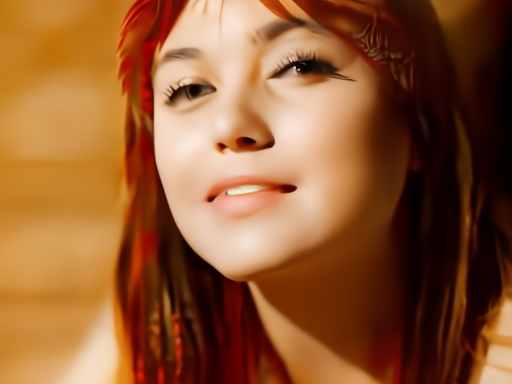

In [12]:
media.show_images([frame.permute(1, 2, 0).numpy().astype('uint8') for frame in (res_comp_L0p0025_N64*255).cpu()], columns=5)  # Display first 10 frames


In [21]:
sum(bitR_L0p0025_N64)

327488.0

In [ ]:
!python video_blend.py result/pexels-koolshooters-7322716 --beg 1 --end 221 --itv 10 --key keys_0p0025 --output result/pexels-koolshooters-7322716/blend_0p0025.mp4 --fps 25.0 --n_proc 4 -ps


## Compression Lambda = 0.0035

Loading /home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.0035.pth.tar
torch.Size([23, 3, 384, 512])
torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.48s
Bitrate: 0.082bpp
MS-SSIM: 16.20dB
PSNR: 33.96dB
Decompressed Image


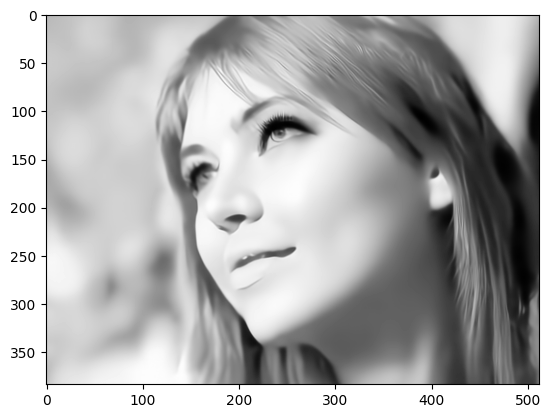

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.104bpp
MS-SSIM: 15.92dB
PSNR: 32.83dB
Decompressed Image


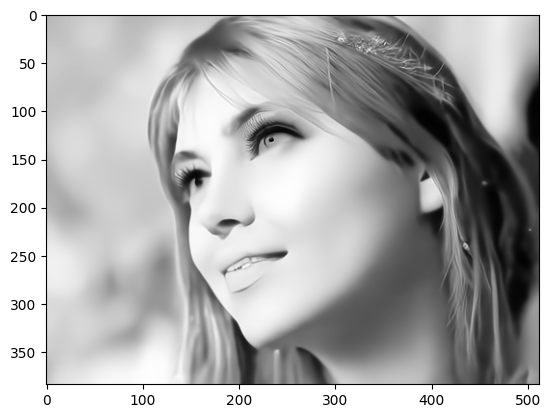

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.109bpp
MS-SSIM: 15.67dB
PSNR: 32.67dB
Decompressed Image


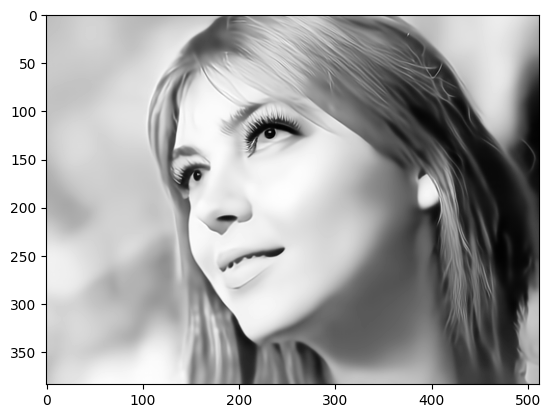

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.58s
Bitrate: 0.115bpp
MS-SSIM: 16.03dB
PSNR: 32.79dB
Decompressed Image


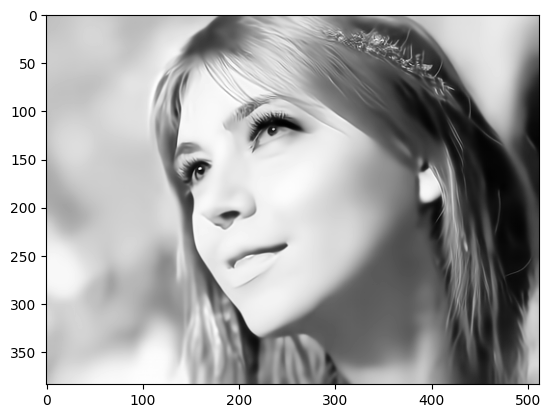

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.108bpp
MS-SSIM: 15.30dB
PSNR: 32.82dB
Decompressed Image


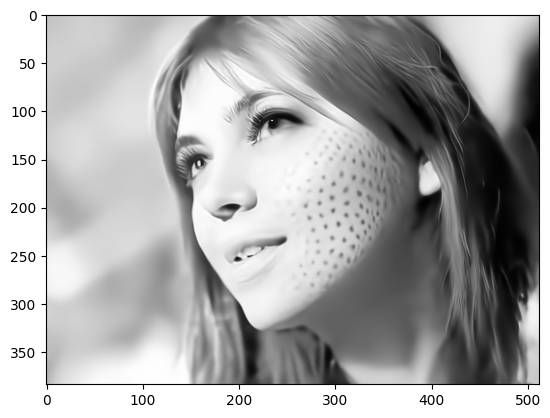

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.106bpp
MS-SSIM: 15.79dB
PSNR: 32.77dB
Decompressed Image


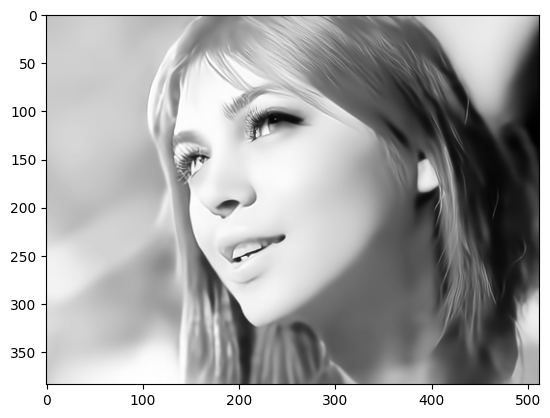

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.52s
Bitrate: 0.111bpp
MS-SSIM: 15.37dB
PSNR: 32.64dB
Decompressed Image


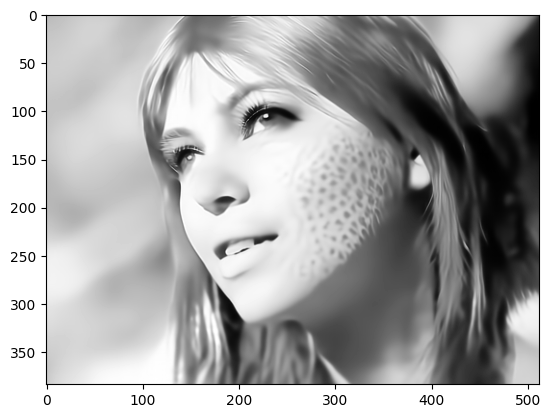

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.109bpp
MS-SSIM: 15.48dB
PSNR: 32.57dB
Decompressed Image


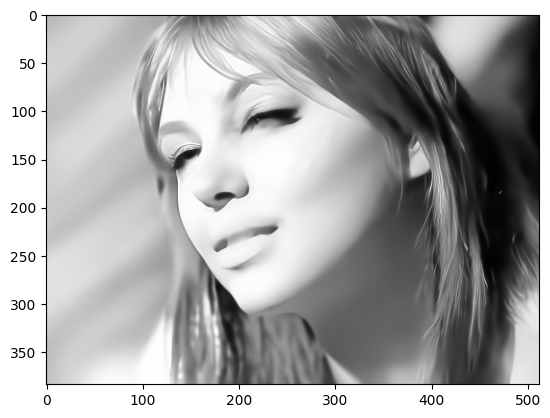

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.48s
Bitrate: 0.080bpp
MS-SSIM: 15.50dB
PSNR: 33.96dB
Decompressed Image


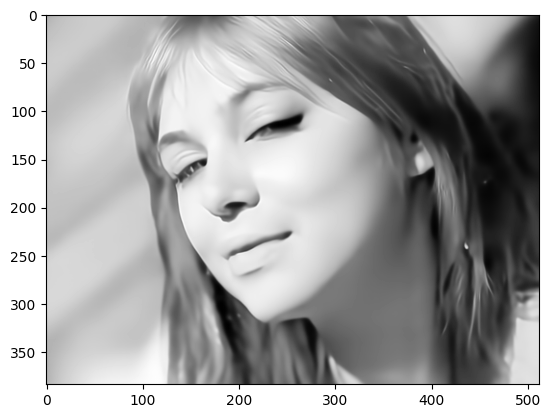

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.092bpp
MS-SSIM: 15.82dB
PSNR: 33.74dB
Decompressed Image


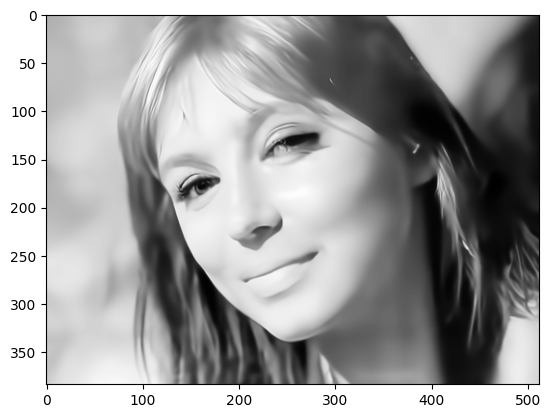

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.60s
Bitrate: 0.087bpp
MS-SSIM: 15.80dB
PSNR: 33.83dB
Decompressed Image


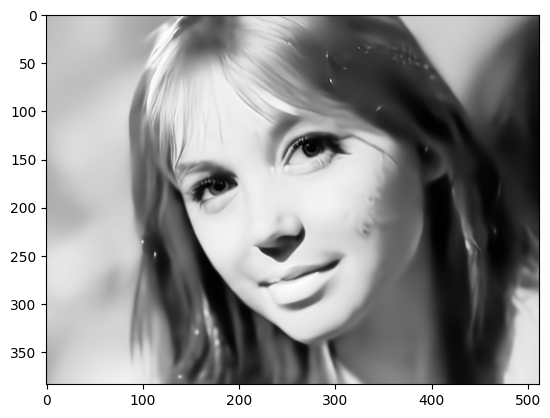

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.67s
Bitrate: 0.089bpp
MS-SSIM: 15.33dB
PSNR: 33.53dB
Decompressed Image


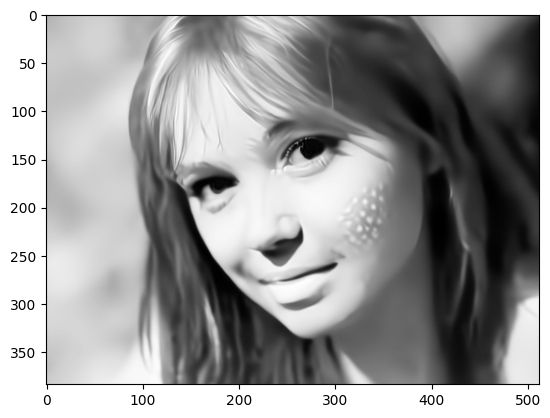

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.081bpp
MS-SSIM: 16.21dB
PSNR: 34.00dB
Decompressed Image


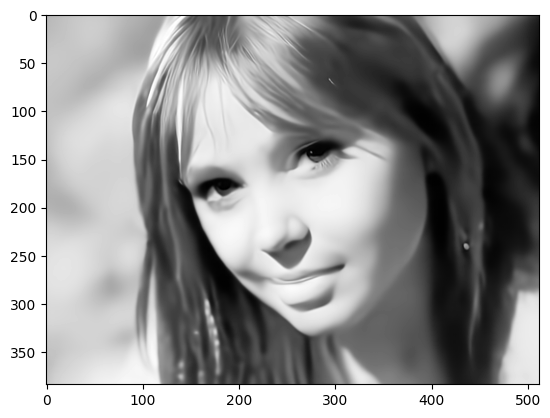

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.080bpp
MS-SSIM: 15.97dB
PSNR: 33.98dB
Decompressed Image


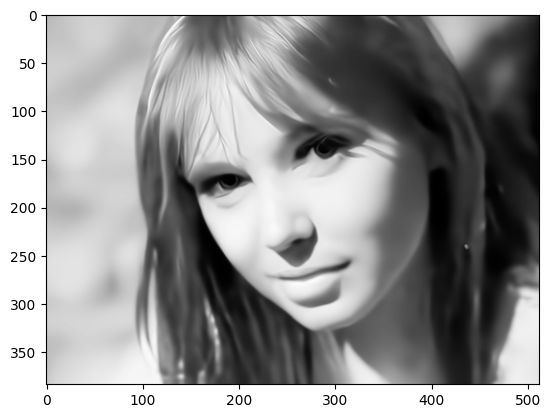

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.53s
Bitrate: 0.072bpp
MS-SSIM: 15.86dB
PSNR: 34.65dB
Decompressed Image


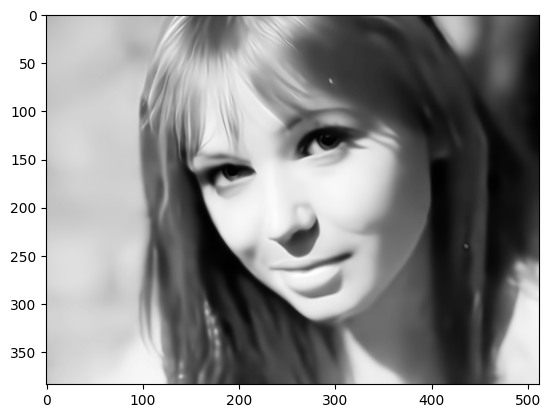

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.076bpp
MS-SSIM: 15.85dB
PSNR: 34.48dB
Decompressed Image


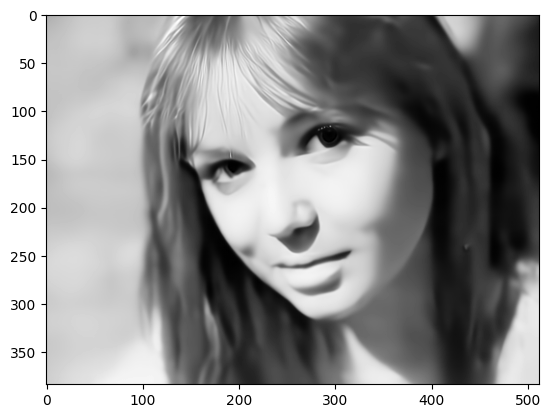

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.50s
Bitrate: 0.075bpp
MS-SSIM: 16.11dB
PSNR: 34.56dB
Decompressed Image


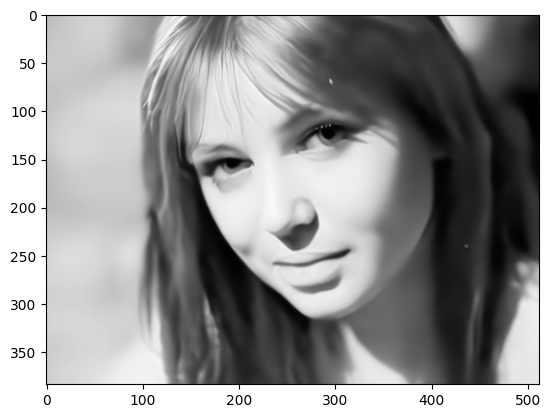

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.53s
Bitrate: 0.082bpp
MS-SSIM: 15.86dB
PSNR: 34.16dB
Decompressed Image


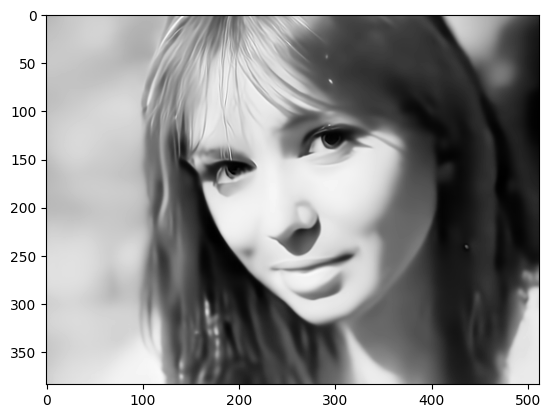

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.072bpp
MS-SSIM: 15.74dB
PSNR: 34.51dB
Decompressed Image


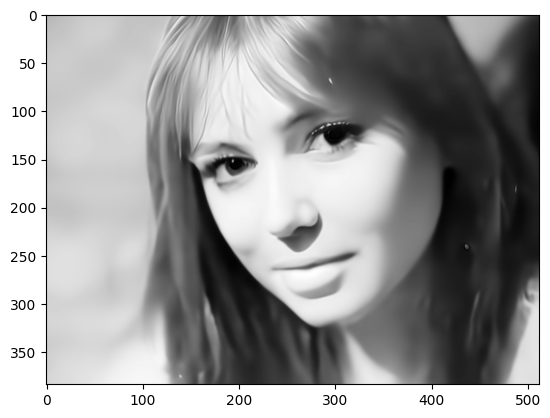

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.48s
Bitrate: 0.072bpp
MS-SSIM: 16.16dB
PSNR: 35.08dB
Decompressed Image


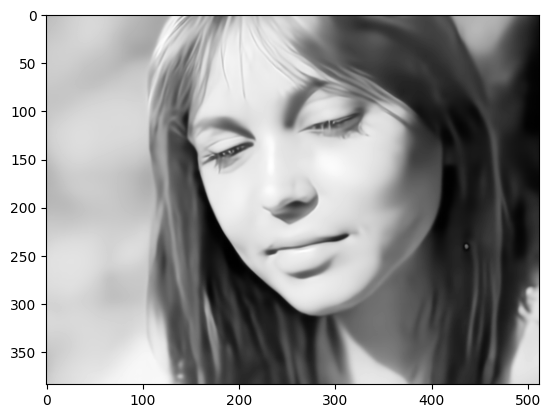

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.071bpp
MS-SSIM: 16.41dB
PSNR: 35.10dB
Decompressed Image


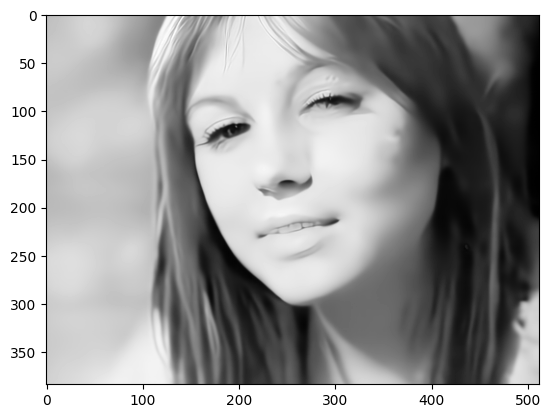

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.071bpp
MS-SSIM: 16.64dB
PSNR: 35.25dB
Decompressed Image


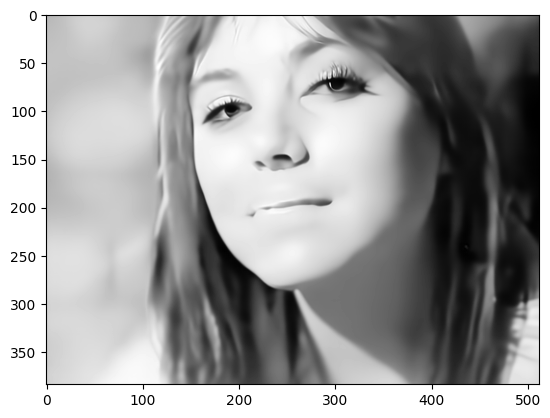

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.50s
Bitrate: 0.076bpp
MS-SSIM: 16.12dB
PSNR: 34.87dB
Decompressed Image


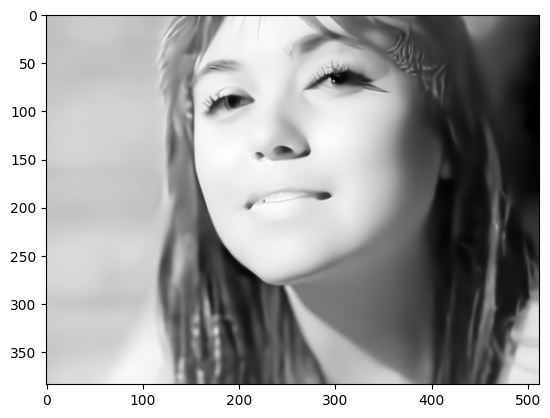

In [22]:
qp = 1
checkpoint_path = '/home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.0035.pth.tar'
Stmp2 = video_tensor1
# Stmp2 = res_tensor
device = 'cuda:1'
res_comp_L0p0035_N64, bitR_L0p0035_N64 = Eval_res2(checkpoint_path , 64, Stmp2, device)

key_dir = "result/pexels-koolshooters-7322716/keys_0p0035"
os.makedirs(key_dir, exist_ok=True)
numpy_array = res_comp_L0p0035_N64.cpu().detach().numpy()
# Assuming numpy_array has values in [0, 1] and shape (23, 3, 384, 512)
for i in range(numpy_array.shape[0]):
    # Rearrange axes from (3, 384, 512) to (384, 512, 3) for RGB
    img_array = np.transpose(numpy_array[i], (1, 2, 0))
    
    # Normalize values to [0, 255] and convert to uint8
    img_array = (img_array * 255).astype(np.uint8)
    
    # Save image
    idx = 10*i + 1
    Image.fromarray(img_array).save(os.path.join(key_dir, f'{idx:04d}.png'))

work_dir = "result/pexels-koolshooters-7322716/"
input_path = "result/pexels-koolshooters-7322716/key.mp4"
interval = 1
fps = get_fps(input_path)
fps //= interval
key_video_path = os.path.join(work_dir, 'key_0p0035.mp4')
frame_to_video(key_video_path, key_dir, fps, False)


In [23]:
sum(bitR_L0p0035_N64)

397120.0

In [17]:
!python video_blend.py result/pexels-koolshooters-7322716 --beg 1 --end 221 --itv 10 --key keys_0p0035 --output result/pexels-koolshooters-7322716/blend_0p0035.mp4 --fps 25.0 --n_proc 4 -ps


/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[

## Copmression_Lambda = 0.0067

Loading /home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.0067.pth.tar
torch.Size([23, 3, 384, 512])
torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.62s
Bitrate: 0.120bpp
MS-SSIM: 17.41dB
PSNR: 35.36dB
Decompressed Image


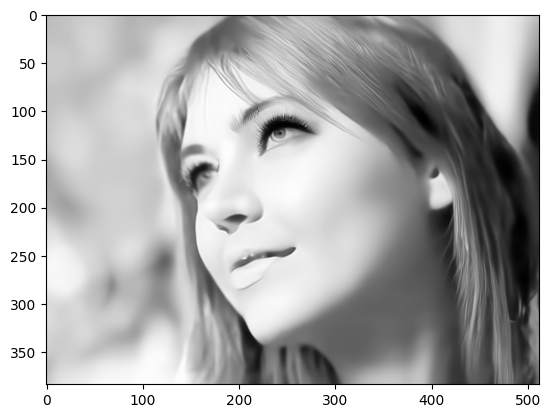

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.156bpp
MS-SSIM: 17.18dB
PSNR: 34.25dB
Decompressed Image


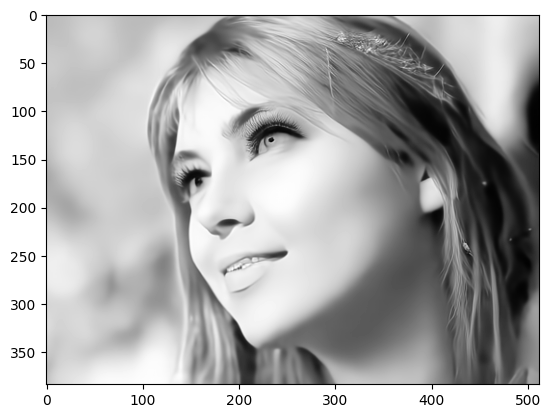

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.161bpp
MS-SSIM: 16.88dB
PSNR: 34.01dB
Decompressed Image


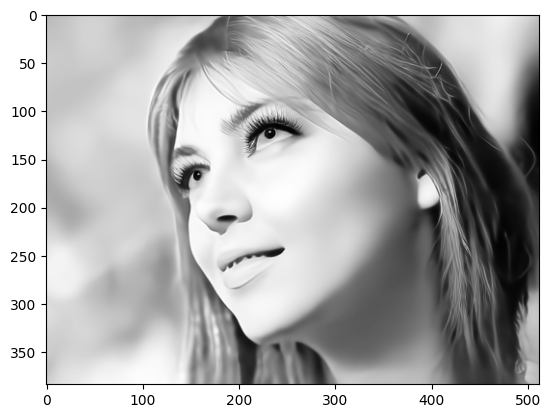

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.52s
Bitrate: 0.169bpp
MS-SSIM: 17.28dB
PSNR: 34.26dB
Decompressed Image


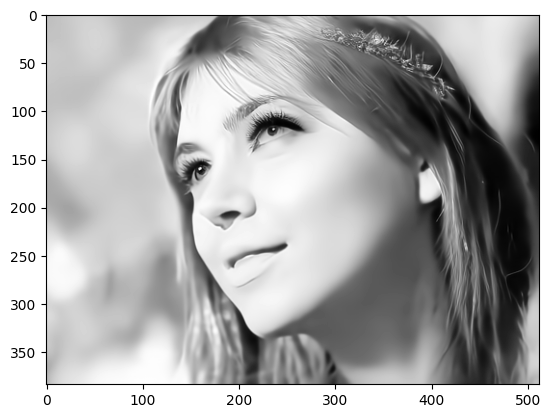

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.162bpp
MS-SSIM: 16.78dB
PSNR: 34.26dB
Decompressed Image


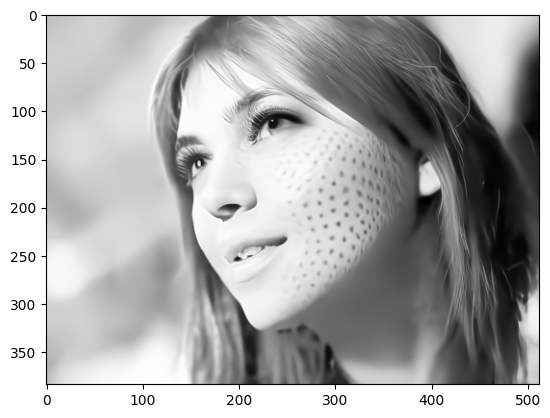

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.157bpp
MS-SSIM: 17.02dB
PSNR: 34.09dB
Decompressed Image


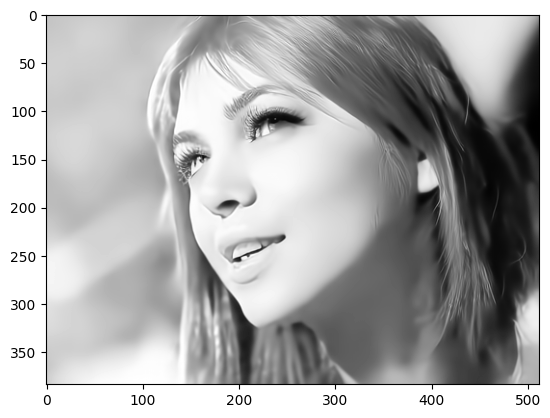

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.165bpp
MS-SSIM: 16.72dB
PSNR: 34.04dB
Decompressed Image


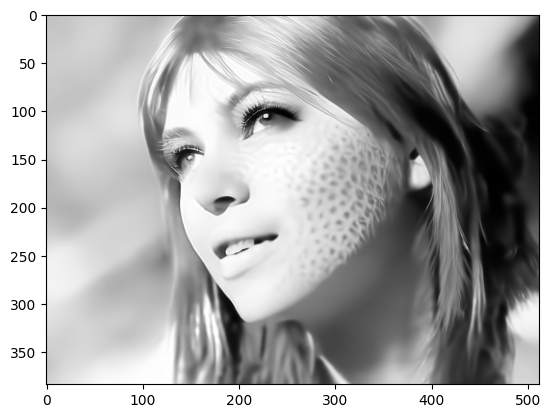

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.52s
Bitrate: 0.162bpp
MS-SSIM: 16.78dB
PSNR: 33.87dB
Decompressed Image


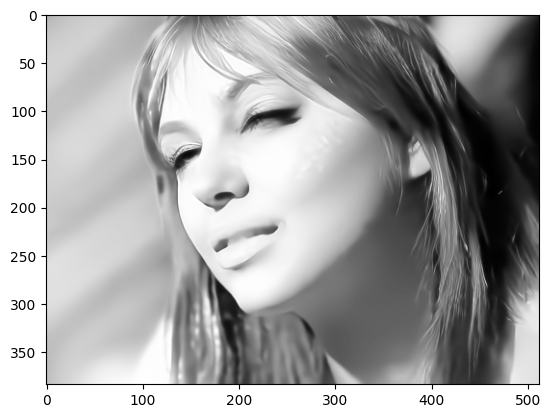

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.117bpp
MS-SSIM: 16.85dB
PSNR: 35.21dB
Decompressed Image


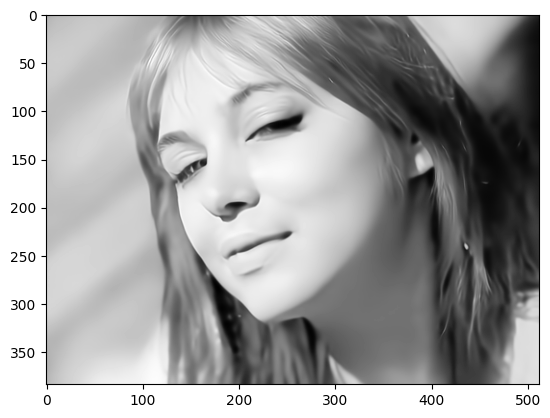

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.131bpp
MS-SSIM: 17.04dB
PSNR: 35.13dB
Decompressed Image


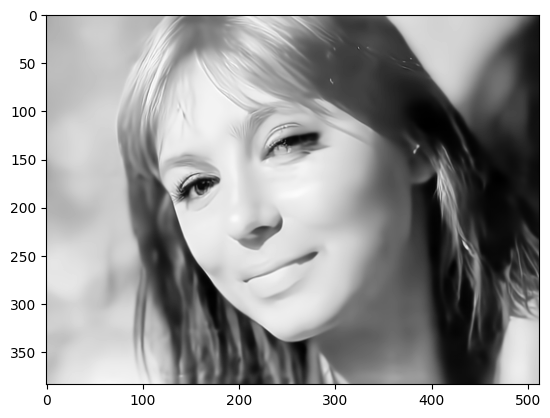

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.50s
Bitrate: 0.124bpp
MS-SSIM: 16.96dB
PSNR: 35.10dB
Decompressed Image


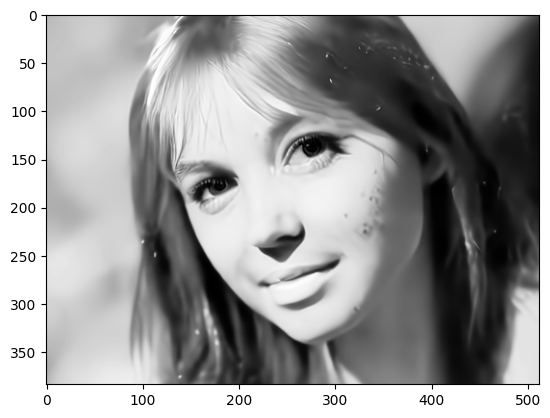

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.129bpp
MS-SSIM: 16.59dB
PSNR: 34.82dB
Decompressed Image


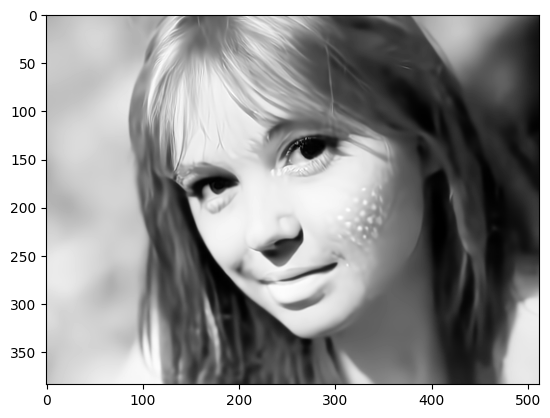

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.118bpp
MS-SSIM: 17.52dB
PSNR: 35.23dB
Decompressed Image


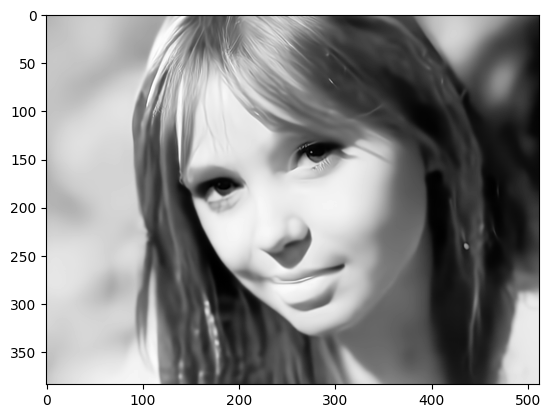

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.50s
Bitrate: 0.114bpp
MS-SSIM: 17.15dB
PSNR: 35.17dB
Decompressed Image


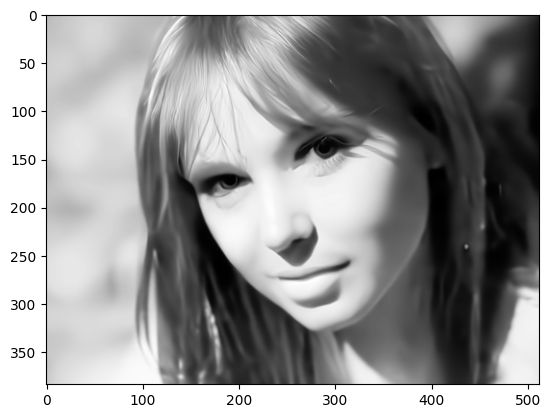

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.101bpp
MS-SSIM: 17.00dB
PSNR: 35.84dB
Decompressed Image


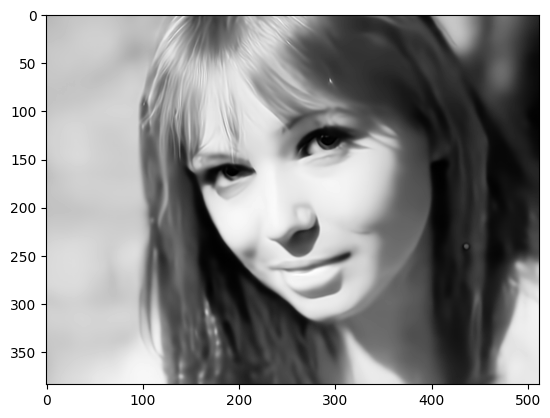

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.48s
Bitrate: 0.107bpp
MS-SSIM: 17.05dB
PSNR: 35.73dB
Decompressed Image


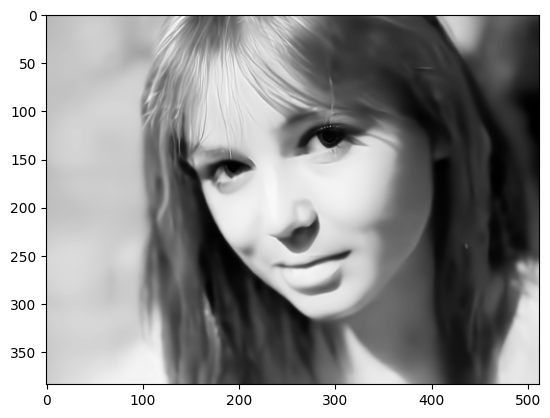

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.52s
Bitrate: 0.107bpp
MS-SSIM: 17.26dB
PSNR: 35.81dB
Decompressed Image


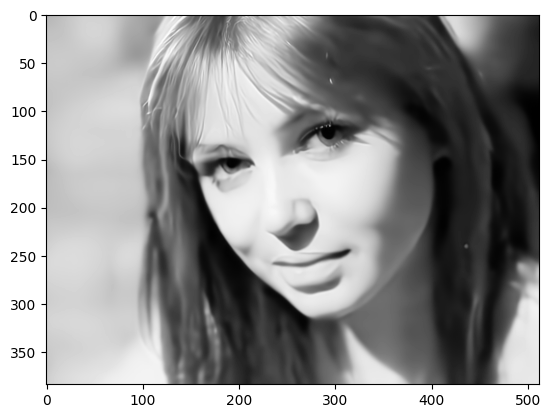

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.50s
Bitrate: 0.115bpp
MS-SSIM: 17.01dB
PSNR: 35.33dB
Decompressed Image


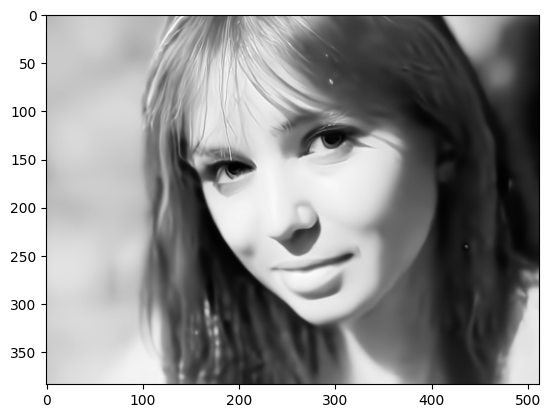

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.49s
Bitrate: 0.104bpp
MS-SSIM: 16.90dB
PSNR: 35.74dB
Decompressed Image


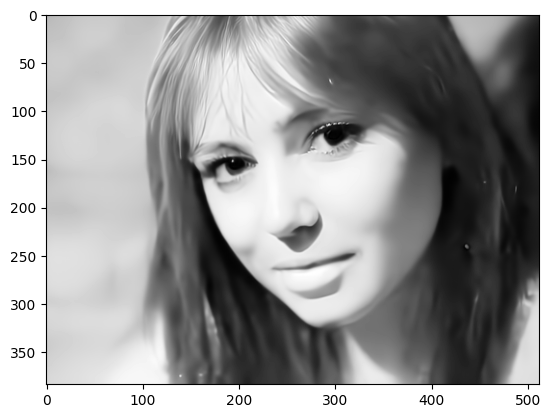

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.51s
Bitrate: 0.100bpp
MS-SSIM: 17.29dB
PSNR: 36.26dB
Decompressed Image


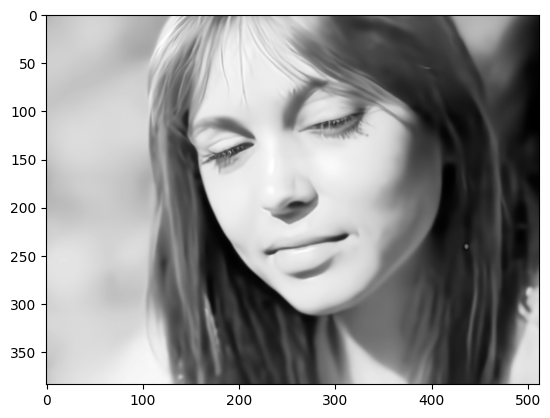

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.66s
Bitrate: 0.097bpp
MS-SSIM: 17.47dB
PSNR: 36.25dB
Decompressed Image


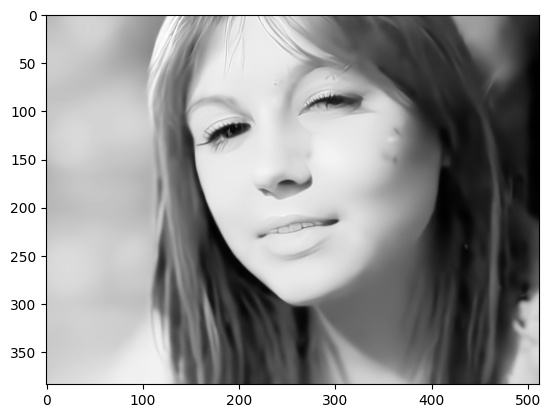

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.097bpp
MS-SSIM: 17.67dB
PSNR: 36.44dB
Decompressed Image


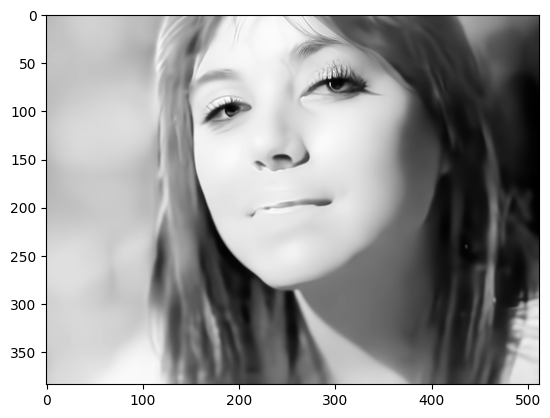

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.47s
Bitrate: 0.107bpp
MS-SSIM: 17.43dB
PSNR: 36.25dB
Decompressed Image


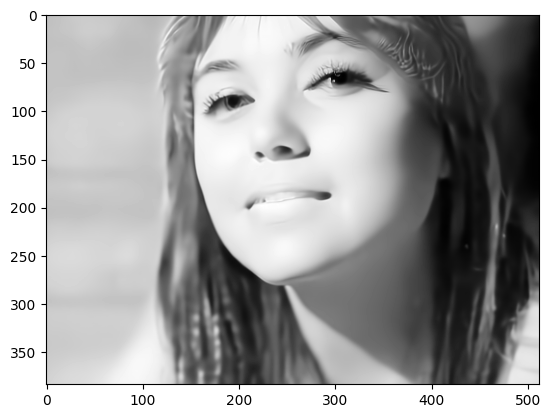

In [24]:
qp = 1
checkpoint_path = '/home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.0067.pth.tar'
Stmp2 = video_tensor1
# Stmp2 = res_tensor
device = 'cuda:1'
res_comp_L0p0067_N64, bitR_L0p0067_N64 = Eval_res2(checkpoint_path , 64, Stmp2, device)

key_dir = "result/pexels-koolshooters-7322716/keys_0p0067"
os.makedirs(key_dir, exist_ok=True)
numpy_array = res_comp_L0p0067_N64.cpu().detach().numpy()
# Assuming numpy_array has values in [0, 1] and shape (23, 3, 384, 512)
for i in range(numpy_array.shape[0]):
    # Rearrange axes from (3, 384, 512) to (384, 512, 3) for RGB
    img_array = np.transpose(numpy_array[i], (1, 2, 0))
    
    # Normalize values to [0, 255] and convert to uint8
    img_array = (img_array * 255).astype(np.uint8)
    
    # Save image
    idx = 10*i + 1
    Image.fromarray(img_array).save(os.path.join(key_dir, f'{idx:04d}.png'))

work_dir = "result/pexels-koolshooters-7322716/"
input_path = "result/pexels-koolshooters-7322716/key.mp4"
interval = 1
fps = get_fps(input_path)
fps //= interval
key_video_path = os.path.join(work_dir, 'key_0p0067.mp4')
frame_to_video(key_video_path, key_dir, fps, False)


In [25]:
sum(bitR_L0p0067_N64)

574176.0

In [9]:
!python video_blend.py result/pexels-koolshooters-7322716 --beg 1 --end 221 --itv 10 --key keys_0p0067 --output result/pexels-koolshooters-7322716/blend_0p0067.mp4 --fps 25.0 --n_proc 4 -ps


/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[

## Copmression_Lambda = 0.013

Loading /home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.013.pth.tar
torch.Size([23, 3, 384, 512])
torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.178bpp
MS-SSIM: 18.58dB
PSNR: 36.70dB
Decompressed Image


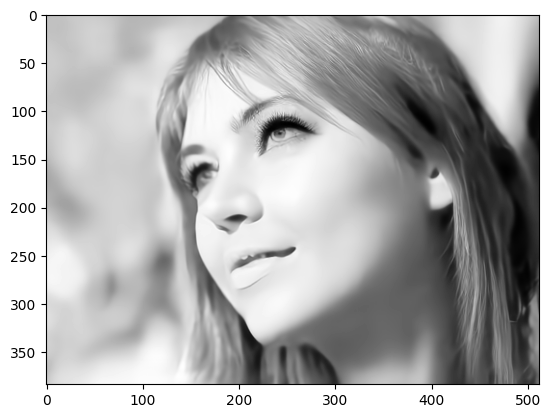

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.53s
Bitrate: 0.230bpp
MS-SSIM: 18.33dB
PSNR: 35.55dB
Decompressed Image


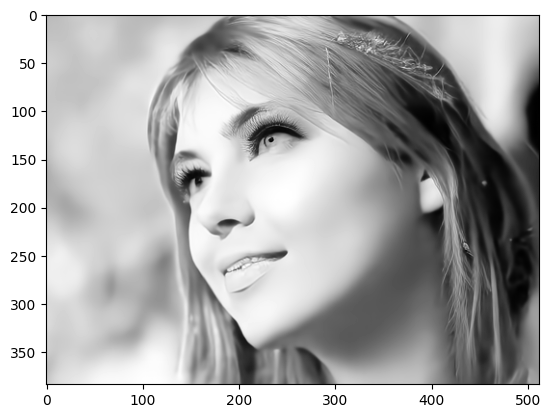

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.240bpp
MS-SSIM: 18.00dB
PSNR: 35.25dB
Decompressed Image


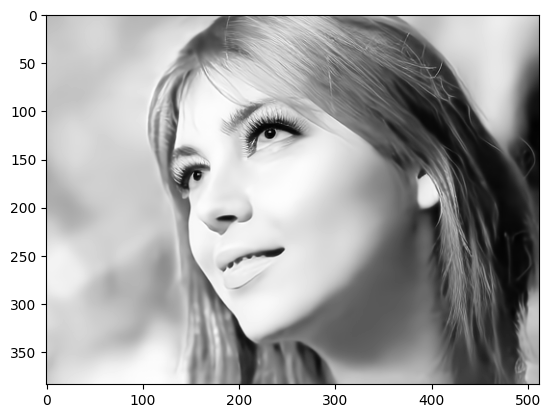

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.60s
Bitrate: 0.244bpp
MS-SSIM: 18.50dB
PSNR: 35.54dB
Decompressed Image


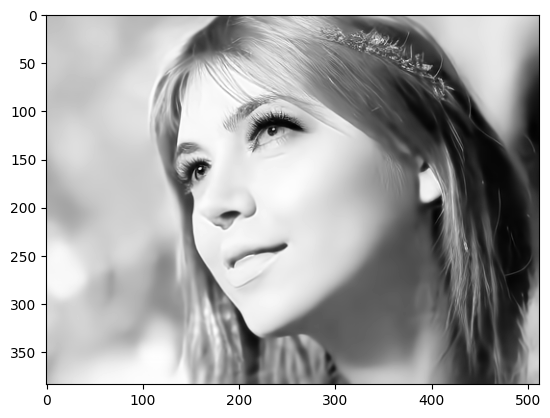

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.69s
Bitrate: 0.240bpp
MS-SSIM: 18.09dB
PSNR: 35.57dB
Decompressed Image


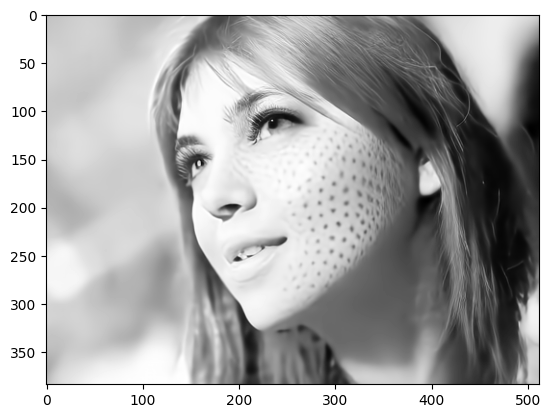

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.237bpp
MS-SSIM: 18.26dB
PSNR: 35.41dB
Decompressed Image


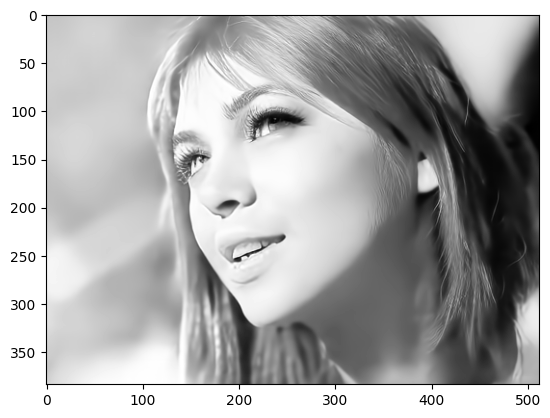

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.53s
Bitrate: 0.241bpp
MS-SSIM: 17.96dB
PSNR: 35.28dB
Decompressed Image


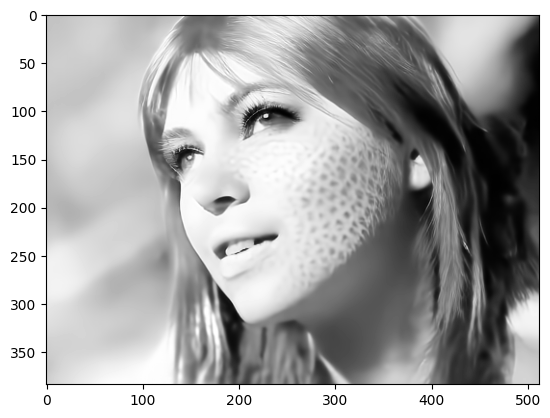

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.50s
Bitrate: 0.245bpp
MS-SSIM: 17.97dB
PSNR: 35.16dB
Decompressed Image


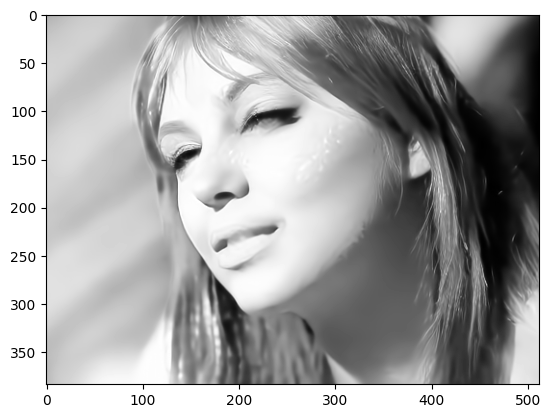

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.50s
Bitrate: 0.173bpp
MS-SSIM: 17.99dB
PSNR: 36.33dB
Decompressed Image


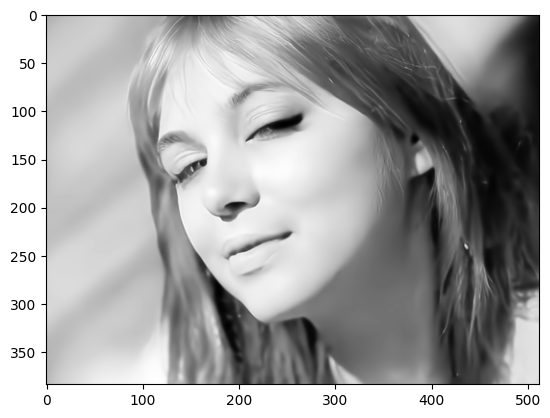

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.67s
Bitrate: 0.188bpp
MS-SSIM: 18.17dB
PSNR: 36.30dB
Decompressed Image


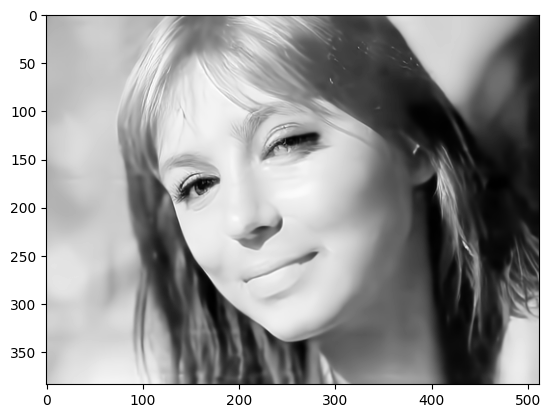

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.52s
Bitrate: 0.180bpp
MS-SSIM: 18.15dB
PSNR: 36.32dB
Decompressed Image


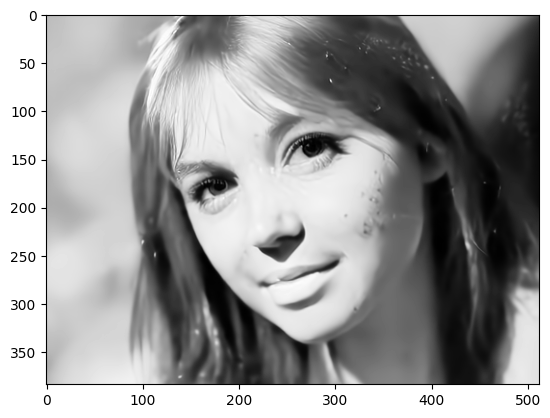

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.52s
Bitrate: 0.189bpp
MS-SSIM: 17.91dB
PSNR: 36.05dB
Decompressed Image


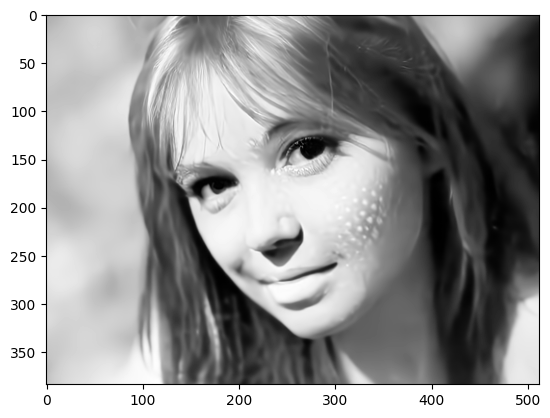

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.175bpp
MS-SSIM: 18.72dB
PSNR: 36.46dB
Decompressed Image


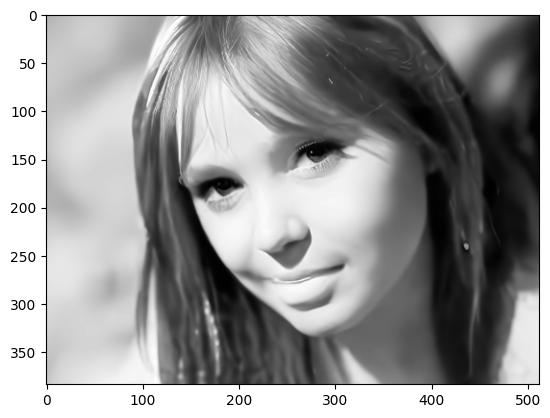

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.58s
Bitrate: 0.172bpp
MS-SSIM: 18.34dB
PSNR: 36.42dB
Decompressed Image


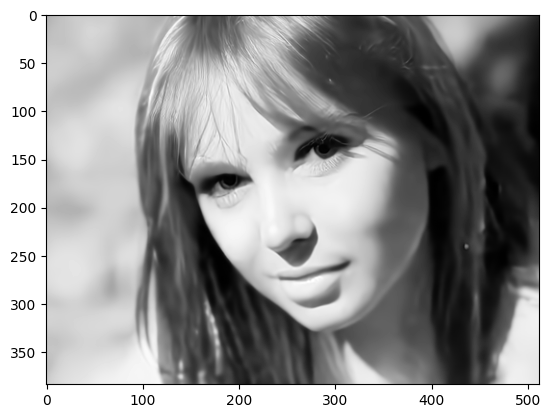

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.150bpp
MS-SSIM: 18.17dB
PSNR: 37.03dB
Decompressed Image


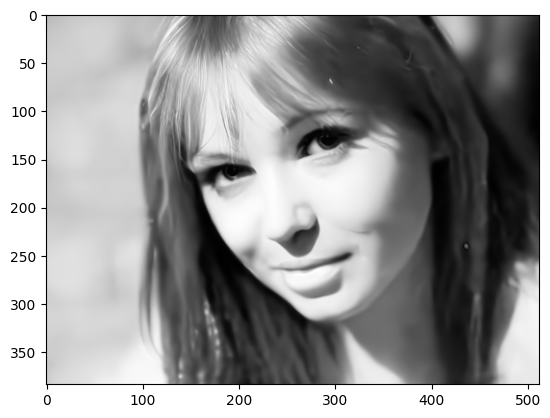

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.49s
Bitrate: 0.157bpp
MS-SSIM: 18.16dB
PSNR: 36.87dB
Decompressed Image


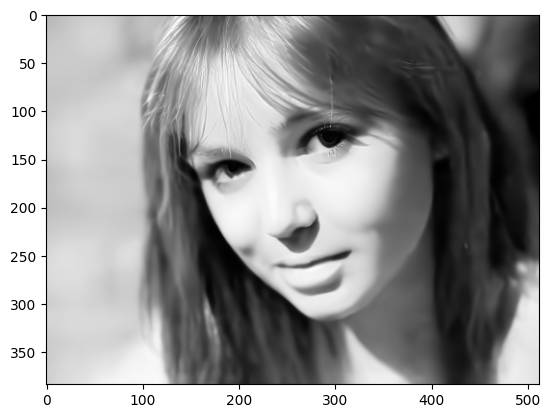

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.53s
Bitrate: 0.156bpp
MS-SSIM: 18.47dB
PSNR: 36.99dB
Decompressed Image


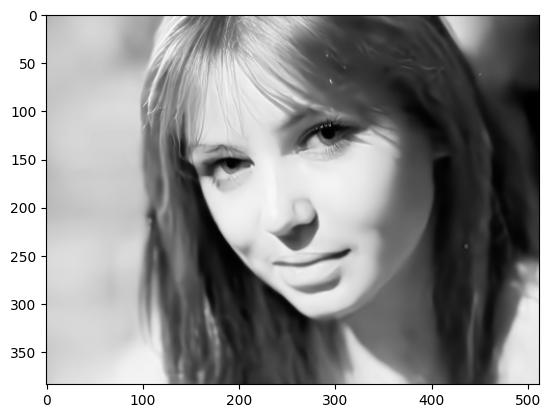

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.171bpp
MS-SSIM: 18.21dB
PSNR: 36.52dB
Decompressed Image


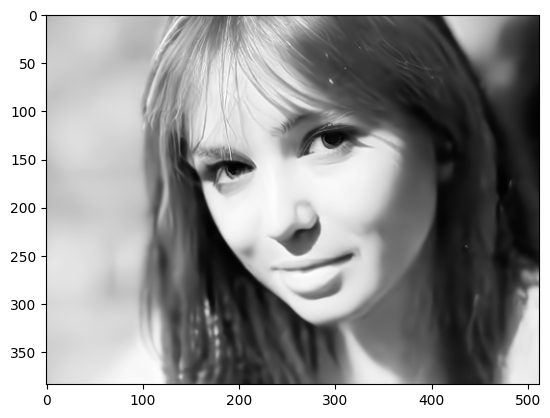

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.51s
Bitrate: 0.153bpp
MS-SSIM: 18.05dB
PSNR: 36.96dB
Decompressed Image


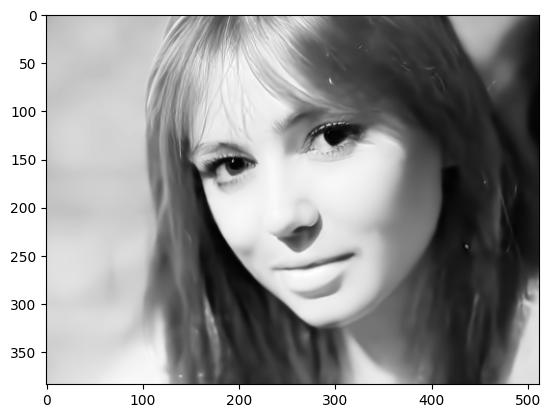

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.51s
Bitrate: 0.141bpp
MS-SSIM: 18.40dB
PSNR: 37.40dB
Decompressed Image


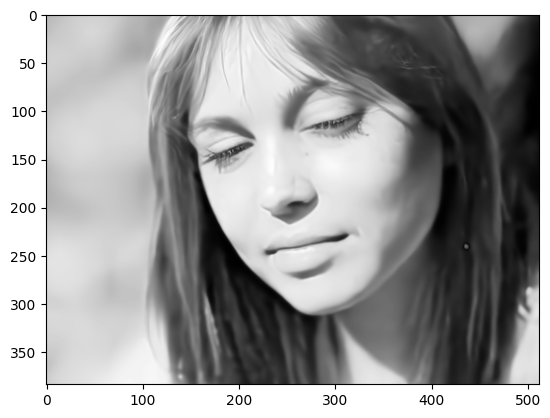

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.54s
Bitrate: 0.140bpp
MS-SSIM: 18.50dB
PSNR: 37.41dB
Decompressed Image


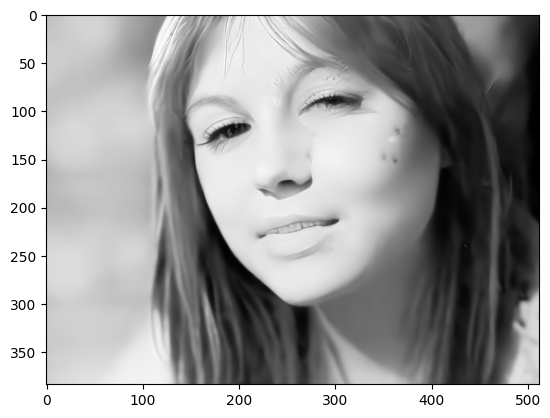

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.51s
Bitrate: 0.137bpp
MS-SSIM: 18.68dB
PSNR: 37.57dB
Decompressed Image


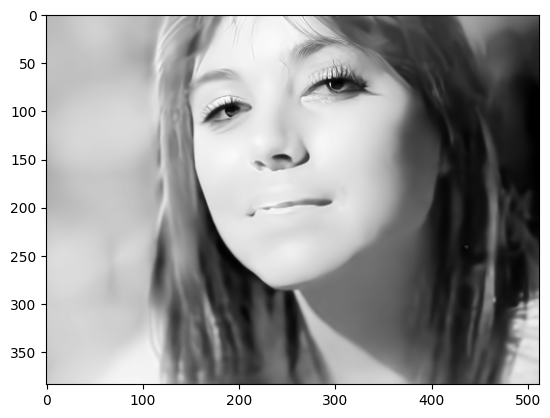

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.151bpp
MS-SSIM: 18.44dB
PSNR: 37.39dB
Decompressed Image


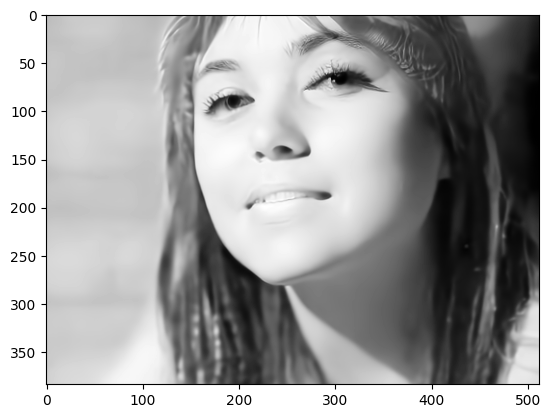

In [26]:
qp = 1

checkpoint_path = '/home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.013.pth.tar'
Stmp2 = video_tensor1
# Stmp2 = res_tensor
device = 'cuda:1'
res_comp_L0p013_N64, bitR_L0p013_N64 = Eval_res2(checkpoint_path , 64, Stmp2, device)

key_dir = "result/pexels-koolshooters-7322716/keys_0p013"
os.makedirs(key_dir, exist_ok=True)
numpy_array = res_comp_L0p013_N64.cpu().detach().numpy()
# Assuming numpy_array has values in [0, 1] and shape (23, 3, 384, 512)
for i in range(numpy_array.shape[0]):
    # Rearrange axes from (3, 384, 512) to (384, 512, 3) for RGB
    img_array = np.transpose(numpy_array[i], (1, 2, 0))
    
    # Normalize values to [0, 255] and convert to uint8
    img_array = (img_array * 255).astype(np.uint8)
    
    # Save image
    idx = 10*i + 1
    Image.fromarray(img_array).save(os.path.join(key_dir, f'{idx:04d}.png'))

work_dir = "result/pexels-koolshooters-7322716/"
input_path = "result/pexels-koolshooters-7322716/key.mp4"
interval = 1
fps = get_fps(input_path)
fps //= interval
key_video_path = os.path.join(work_dir, 'key_0p013.mp4')
frame_to_video(key_video_path, key_dir, fps, False)


In [27]:
sum(bitR_L0p013_N64)

843200.0

In [11]:
!python video_blend.py result/pexels-koolshooters-7322716 --beg 1 --end 221 --itv 10 --key keys_0p013 --output result/pexels-koolshooters-7322716/blend_0p013.mp4 --fps 25.0 --n_proc 4 -ps


/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[

## Copmression_Lambda = 0.025

Loading /home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.025.pth.tar
torch.Size([23, 3, 384, 512])
torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.261bpp
MS-SSIM: 19.69dB
PSNR: 38.10dB
Decompressed Image


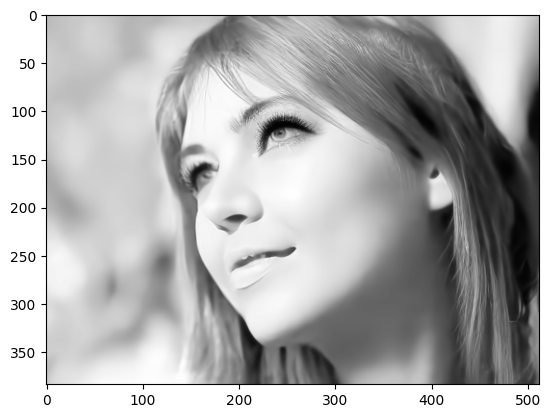

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.60s
Bitrate: 0.342bpp
MS-SSIM: 19.44dB
PSNR: 37.14dB
Decompressed Image


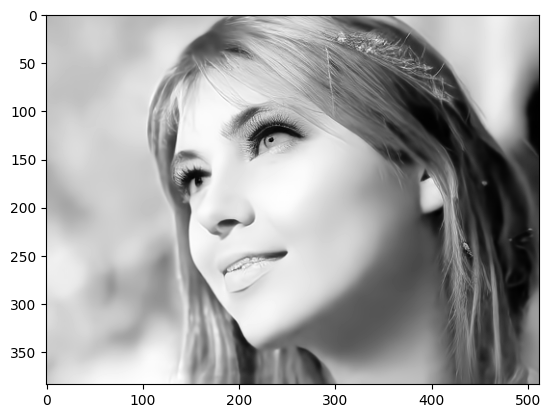

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.363bpp
MS-SSIM: 19.20dB
PSNR: 36.84dB
Decompressed Image


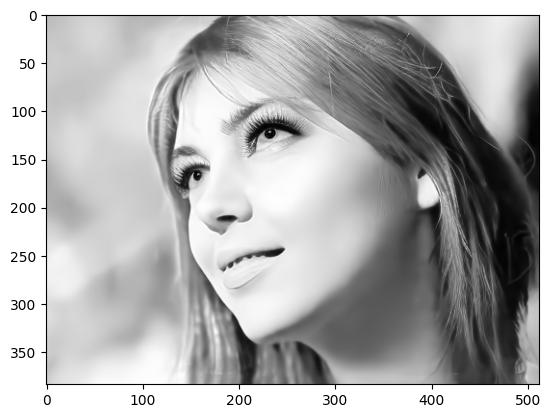

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.65s
Bitrate: 0.355bpp
MS-SSIM: 19.62dB
PSNR: 37.11dB
Decompressed Image


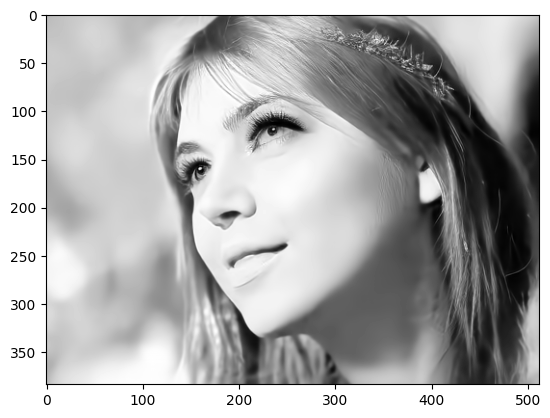

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.359bpp
MS-SSIM: 19.47dB
PSNR: 37.21dB
Decompressed Image


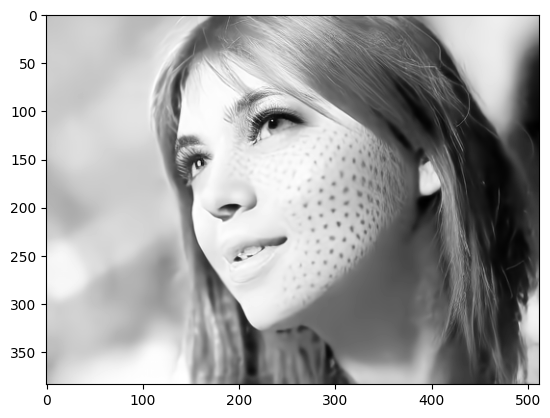

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.61s
Bitrate: 0.354bpp
MS-SSIM: 19.45dB
PSNR: 37.06dB
Decompressed Image


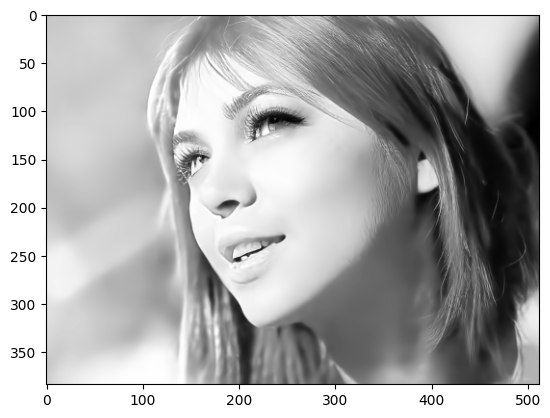

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.66s
Bitrate: 0.357bpp
MS-SSIM: 19.19dB
PSNR: 36.76dB
Decompressed Image


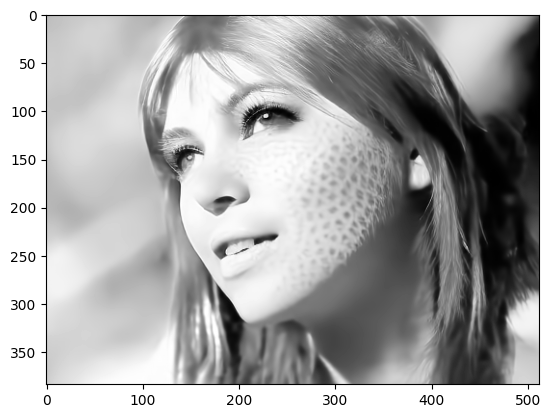

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.365bpp
MS-SSIM: 19.19dB
PSNR: 36.66dB
Decompressed Image


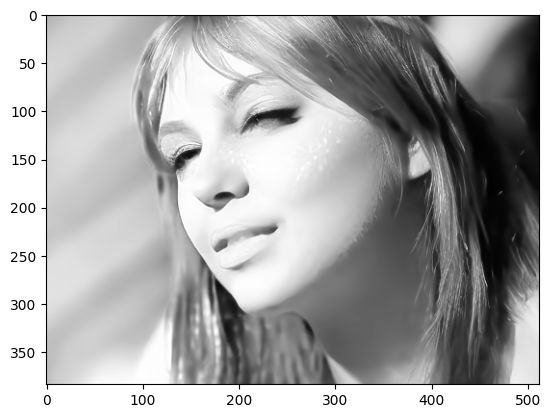

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.61s
Bitrate: 0.257bpp
MS-SSIM: 19.06dB
PSNR: 37.60dB
Decompressed Image


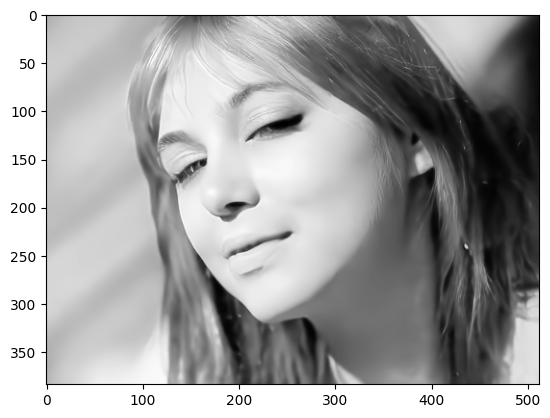

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.271bpp
MS-SSIM: 19.31dB
PSNR: 37.55dB
Decompressed Image


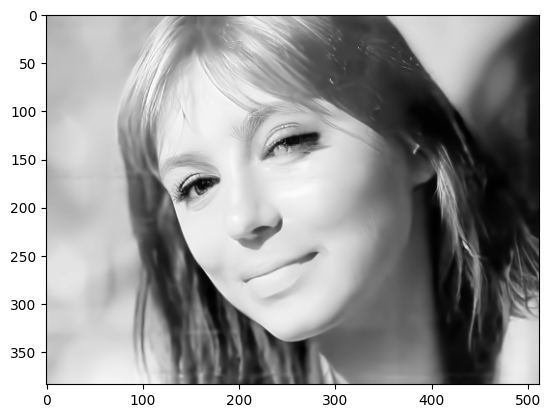

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.270bpp
MS-SSIM: 19.36dB
PSNR: 37.64dB
Decompressed Image


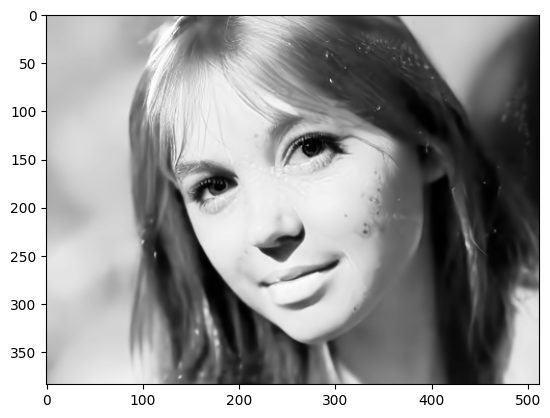

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.66s
Bitrate: 0.283bpp
MS-SSIM: 19.19dB
PSNR: 37.36dB
Decompressed Image


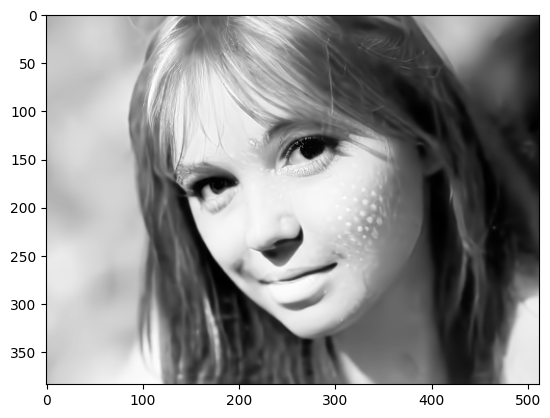

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.67s
Bitrate: 0.260bpp
MS-SSIM: 19.83dB
PSNR: 37.89dB
Decompressed Image


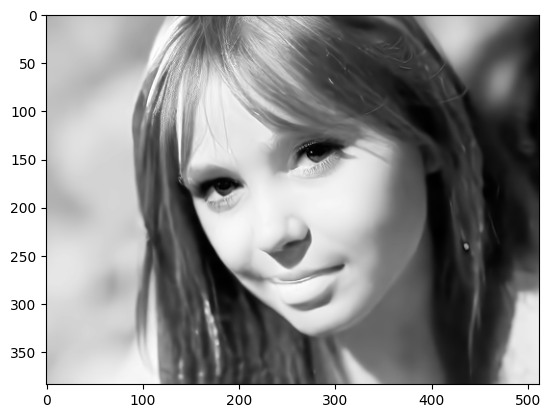

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.64s
Bitrate: 0.259bpp
MS-SSIM: 19.58dB
PSNR: 37.81dB
Decompressed Image


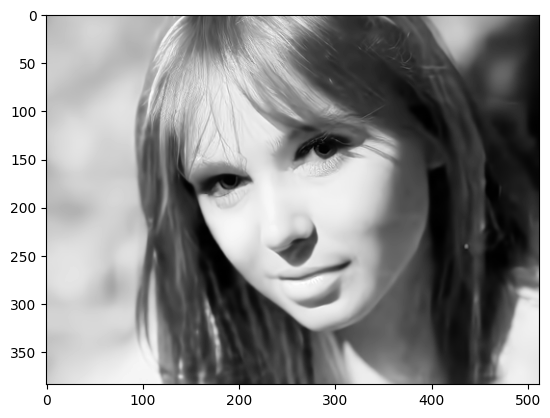

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.220bpp
MS-SSIM: 19.25dB
PSNR: 38.21dB
Decompressed Image


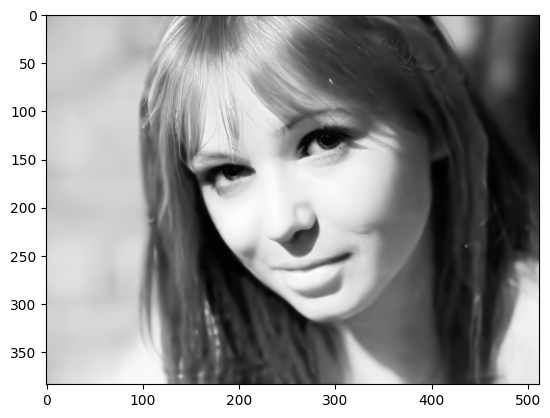

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.62s
Bitrate: 0.233bpp
MS-SSIM: 19.27dB
PSNR: 38.12dB
Decompressed Image


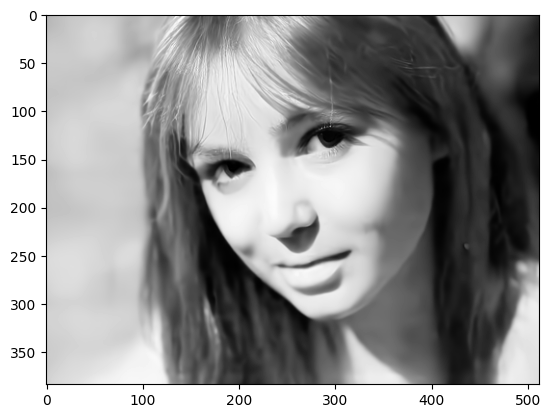

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.48s
Bitrate: 0.228bpp
MS-SSIM: 19.53dB
PSNR: 38.27dB
Decompressed Image


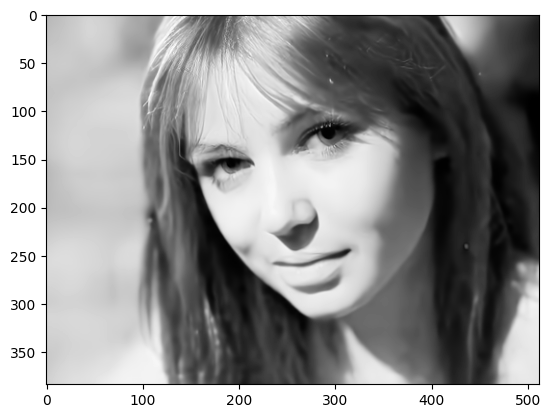

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.249bpp
MS-SSIM: 19.31dB
PSNR: 37.79dB
Decompressed Image


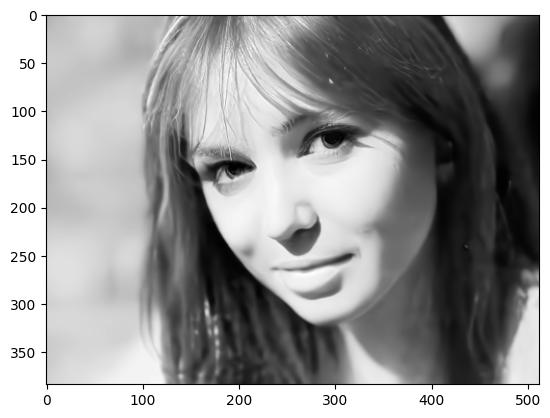

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.49s
Bitrate: 0.228bpp
MS-SSIM: 19.23dB
PSNR: 38.21dB
Decompressed Image


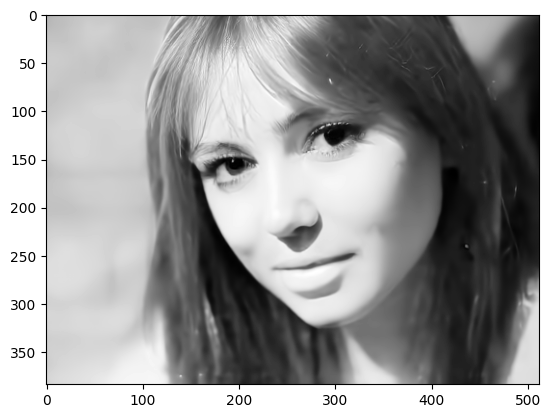

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.205bpp
MS-SSIM: 19.49dB
PSNR: 38.53dB
Decompressed Image


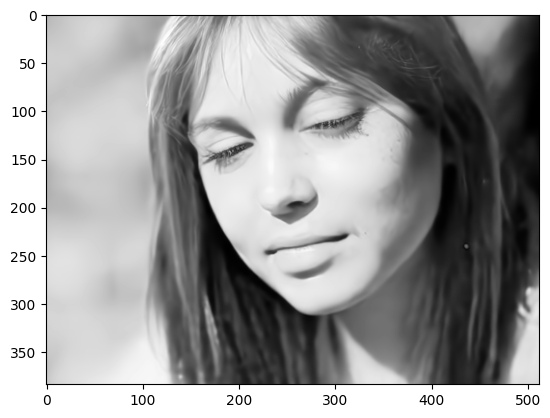

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.203bpp
MS-SSIM: 19.48dB
PSNR: 38.55dB
Decompressed Image


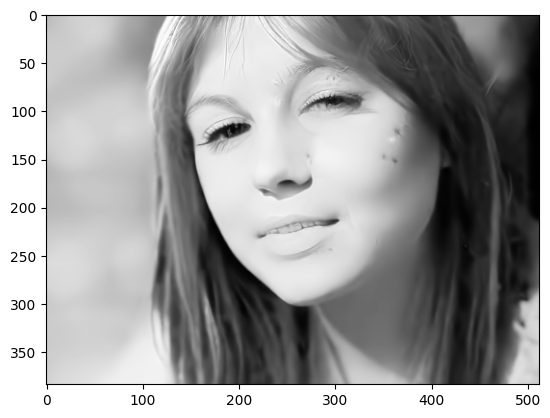

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.69s
Bitrate: 0.196bpp
MS-SSIM: 19.62dB
PSNR: 38.75dB
Decompressed Image


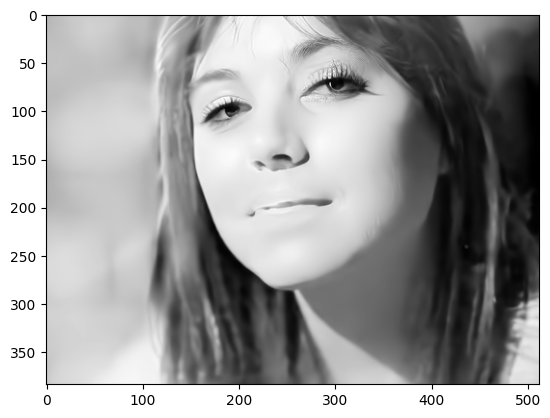

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.214bpp
MS-SSIM: 19.46dB
PSNR: 38.62dB
Decompressed Image


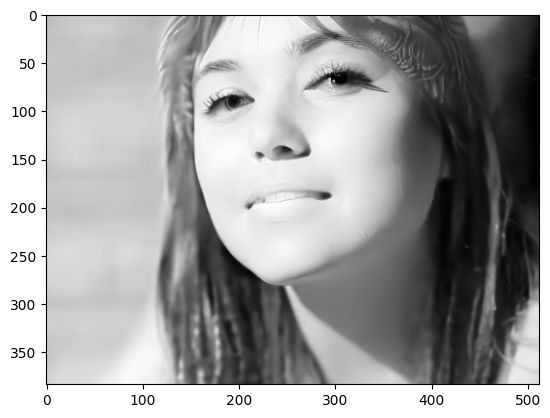

In [28]:
qp = 1
checkpoint_path = '/home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.025.pth.tar'
Stmp2 = video_tensor1
# Stmp2 = res_tensor
device = 'cuda:1'
res_comp_L0p025_N64, bitR_L0p025_N64 = Eval_res2(checkpoint_path , 64, Stmp2, device)

key_dir = "result/pexels-koolshooters-7322716/keys_0p025"
os.makedirs(key_dir, exist_ok=True)
numpy_array = res_comp_L0p025_N64.cpu().detach().numpy()
# Assuming numpy_array has values in [0, 1] and shape (23, 3, 384, 512)
for i in range(numpy_array.shape[0]):
    # Rearrange axes from (3, 384, 512) to (384, 512, 3) for RGB
    img_array = np.transpose(numpy_array[i], (1, 2, 0))
    
    # Normalize values to [0, 255] and convert to uint8
    img_array = (img_array * 255).astype(np.uint8)
    
    # Save image
    idx = 10*i + 1
    Image.fromarray(img_array).save(os.path.join(key_dir, f'{idx:04d}.png'))

work_dir = "result/pexels-koolshooters-7322716/"
input_path = "result/pexels-koolshooters-7322716/key.mp4"
interval = 1
fps = get_fps(input_path)
fps //= interval
key_video_path = os.path.join(work_dir, 'key_0p025.mp4')
frame_to_video(key_video_path, key_dir, fps, False)


In [29]:
sum(bitR_L0p025_N64)

1244928.0

In [13]:
!python video_blend.py result/pexels-koolshooters-7322716 --beg 1 --end 221 --itv 10 --key keys_0p025 --output result/pexels-koolshooters-7322716/blend_0p025.mp4 --fps 25.0 --n_proc 4 -ps


/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[

## Copmression_Lambda = 0.05

Loading /home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.05.pth.tar
torch.Size([23, 3, 384, 512])
torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.380bpp
MS-SSIM: 20.97dB
PSNR: 39.73dB
Decompressed Image


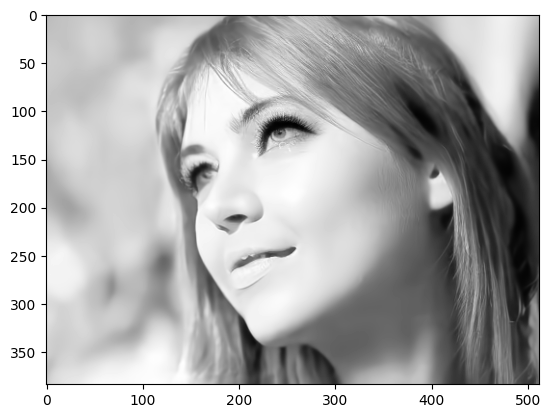

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.56s
Bitrate: 0.490bpp
MS-SSIM: 20.68dB
PSNR: 38.85dB
Decompressed Image


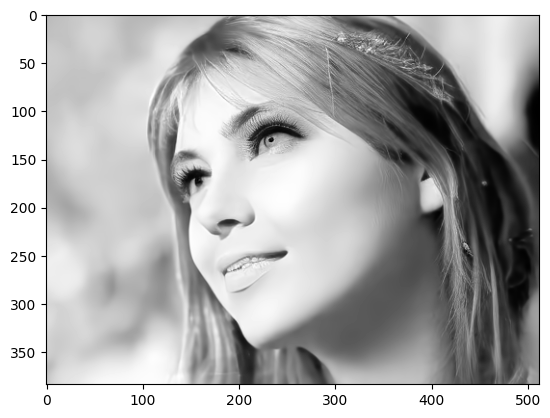

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.60s
Bitrate: 0.527bpp
MS-SSIM: 20.53dB
PSNR: 38.57dB
Decompressed Image


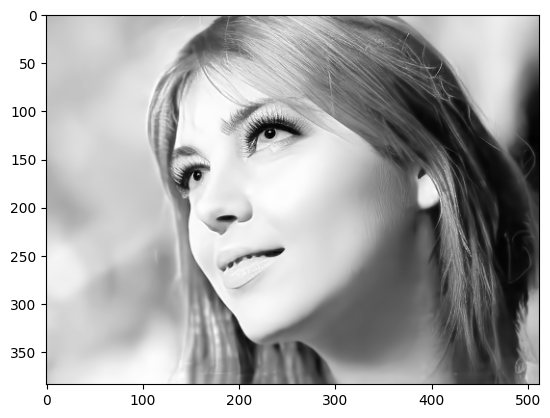

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.58s
Bitrate: 0.508bpp
MS-SSIM: 20.92dB
PSNR: 38.86dB
Decompressed Image


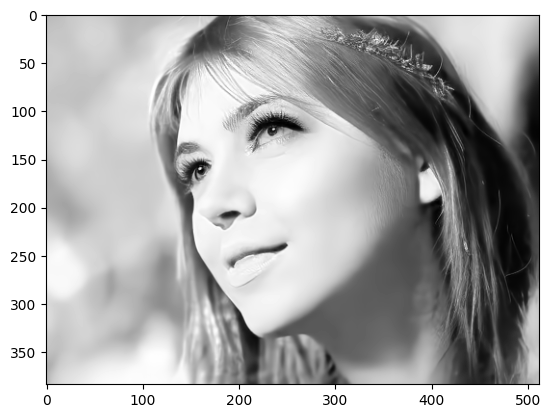

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.61s
Bitrate: 0.514bpp
MS-SSIM: 20.89dB
PSNR: 38.99dB
Decompressed Image


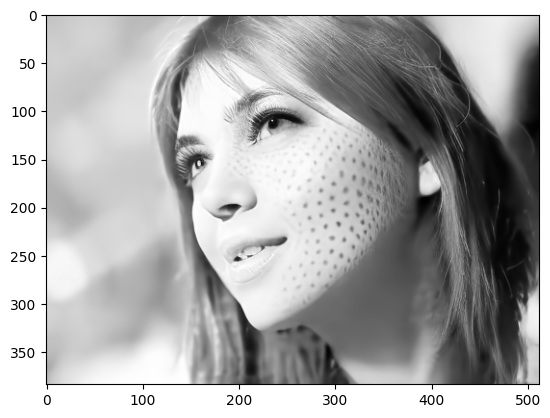

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.73s
Bitrate: 0.511bpp
MS-SSIM: 20.76dB
PSNR: 38.79dB
Decompressed Image


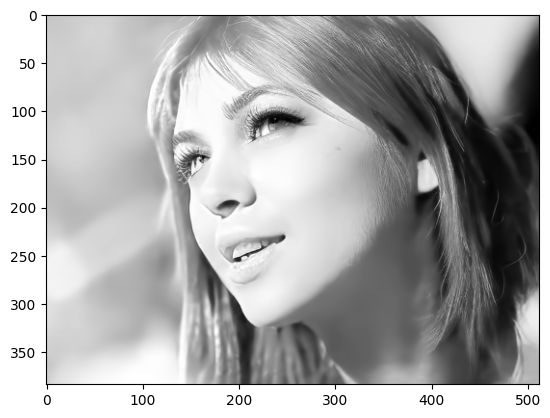

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.57s
Bitrate: 0.512bpp
MS-SSIM: 20.42dB
PSNR: 38.30dB
Decompressed Image


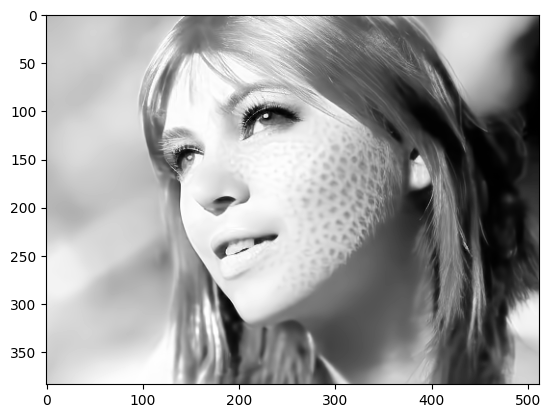

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.528bpp
MS-SSIM: 20.57dB
PSNR: 38.35dB
Decompressed Image


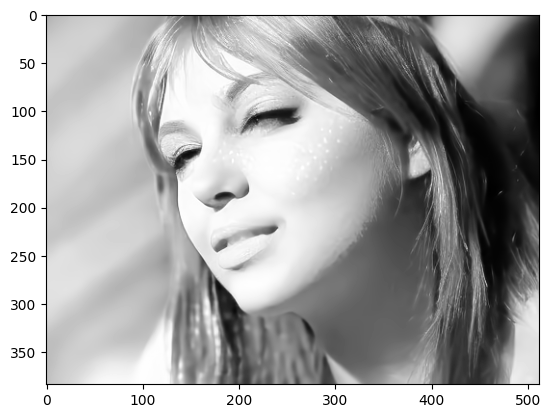

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.383bpp
MS-SSIM: 20.27dB
PSNR: 39.07dB
Decompressed Image


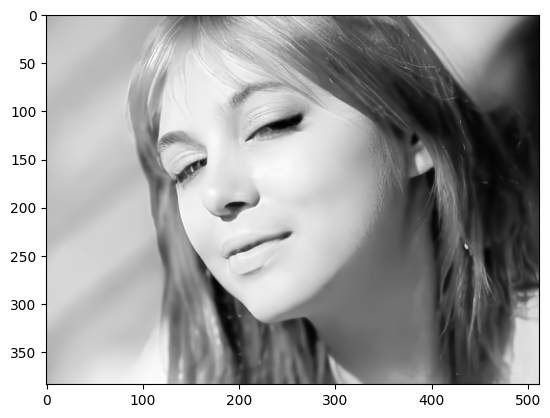

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.62s
Bitrate: 0.384bpp
MS-SSIM: 20.41dB
PSNR: 38.91dB
Decompressed Image


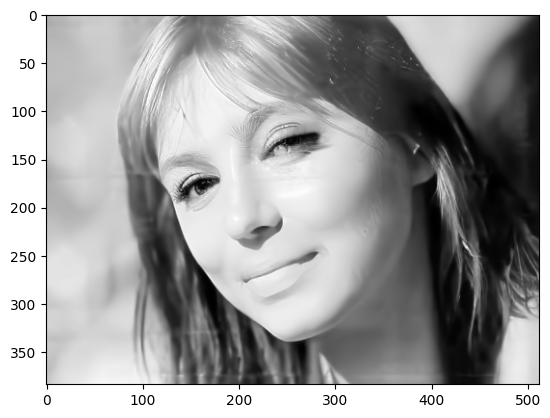

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.390bpp
MS-SSIM: 20.69dB
PSNR: 39.16dB
Decompressed Image


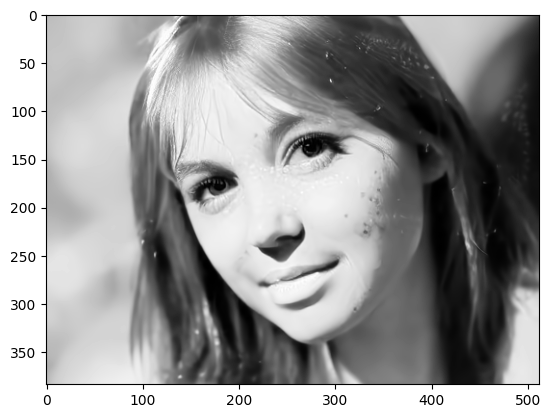

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.53s
Bitrate: 0.412bpp
MS-SSIM: 20.47dB
PSNR: 38.90dB
Decompressed Image


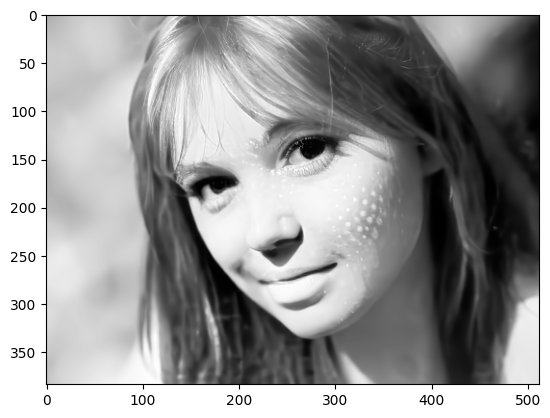

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.58s
Bitrate: 0.370bpp
MS-SSIM: 21.06dB
PSNR: 39.46dB
Decompressed Image


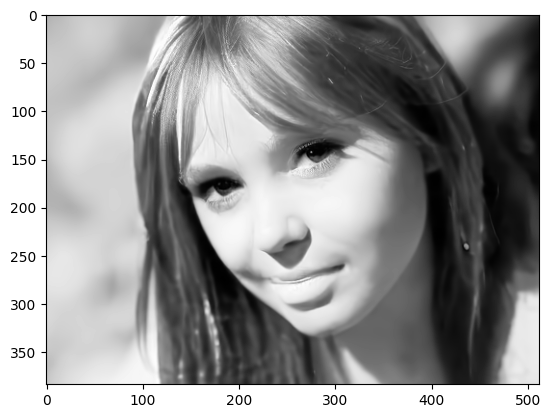

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.378bpp
MS-SSIM: 20.82dB
PSNR: 39.39dB
Decompressed Image


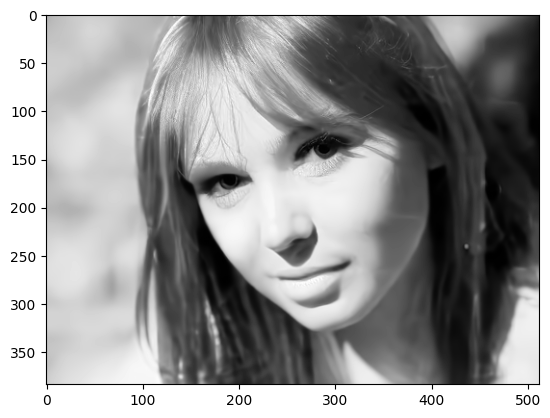

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.63s
Bitrate: 0.324bpp
MS-SSIM: 20.55dB
PSNR: 39.69dB
Decompressed Image


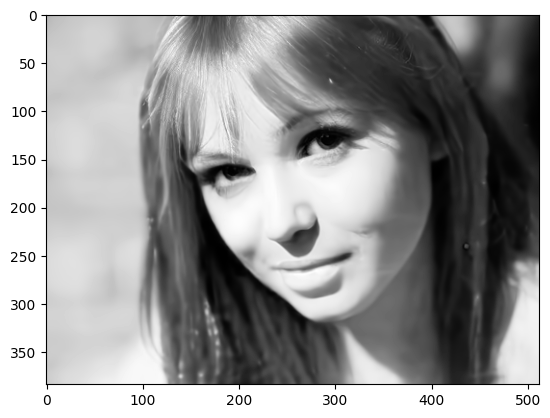

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.58s
Bitrate: 0.336bpp
MS-SSIM: 20.47dB
PSNR: 39.58dB
Decompressed Image


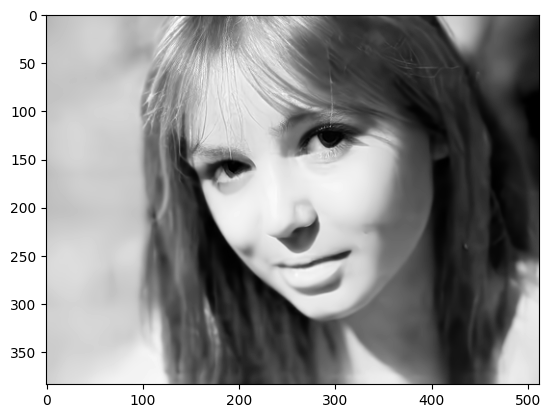

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.331bpp
MS-SSIM: 20.76dB
PSNR: 39.75dB
Decompressed Image


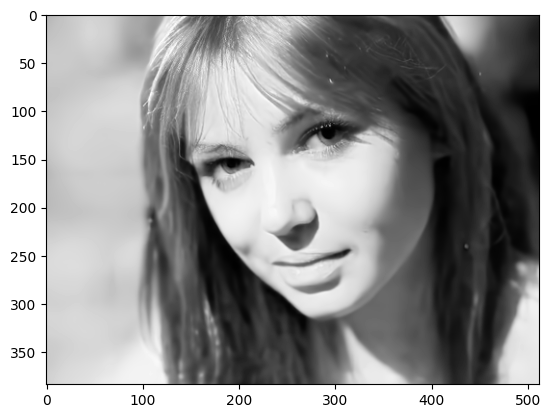

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.61s
Bitrate: 0.365bpp
MS-SSIM: 20.52dB
PSNR: 39.25dB
Decompressed Image


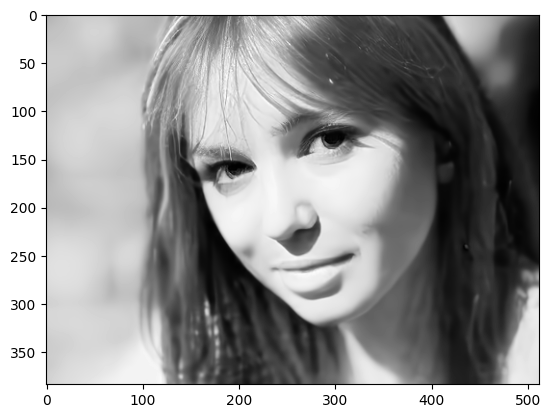

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.332bpp
MS-SSIM: 20.47dB
PSNR: 39.66dB
Decompressed Image


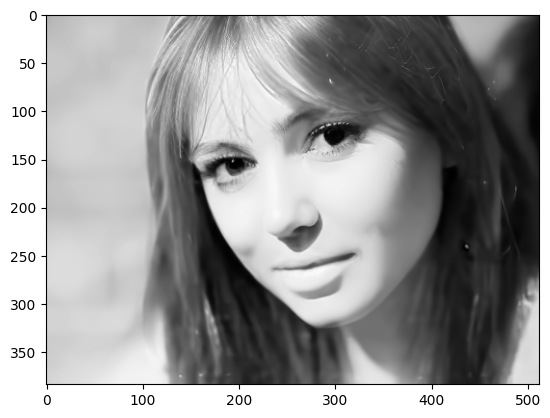

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.297bpp
MS-SSIM: 20.65dB
PSNR: 39.87dB
Decompressed Image


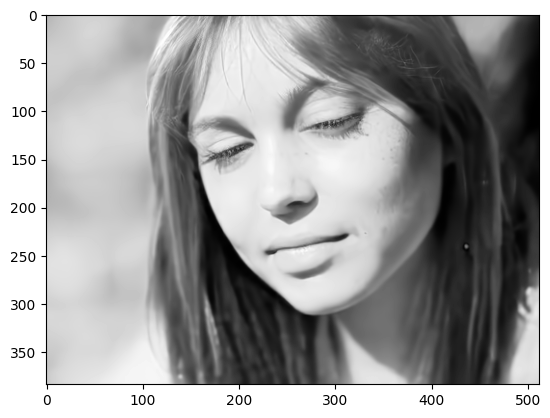

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.60s
Bitrate: 0.293bpp
MS-SSIM: 20.66dB
PSNR: 39.96dB
Decompressed Image


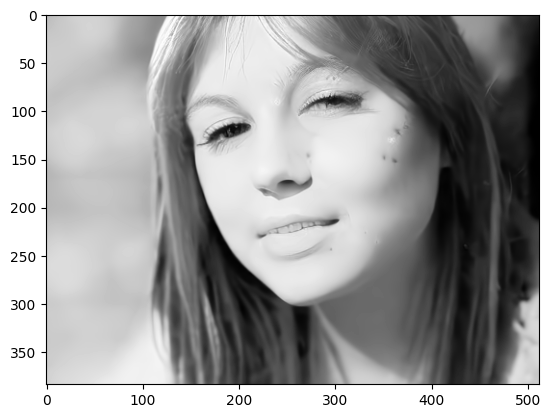

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.59s
Bitrate: 0.274bpp
MS-SSIM: 20.72dB
PSNR: 40.07dB
Decompressed Image


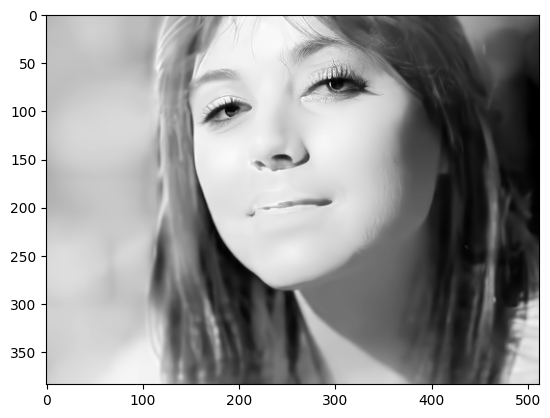

torch.Size([1, 3, 384, 512])
torch.Size([1, 3, 384, 512])
Time: 0.55s
Bitrate: 0.302bpp
MS-SSIM: 20.57dB
PSNR: 40.01dB
Decompressed Image


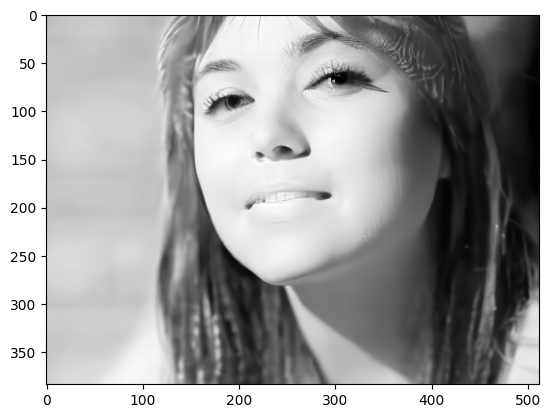

In [30]:
qp = 1
checkpoint_path = '/home/shubham/code/genAI/genaiProject/Rerender_A_Video/compression/0.05.pth.tar'
Stmp2 = video_tensor1
# Stmp2 = res_tensor
device = 'cuda:1'
res_comp_L0p05_N128, bitR_L0p05_N128 = Eval_res2(checkpoint_path , 128, Stmp2, device)

key_dir = "result/pexels-koolshooters-7322716/keys_0p05"
os.makedirs(key_dir, exist_ok=True)
numpy_array = res_comp_L0p05_N128.cpu().detach().numpy()
# Assuming numpy_array has values in [0, 1] and shape (23, 3, 384, 512)
for i in range(numpy_array.shape[0]):
    # Rearrange axes from (3, 384, 512) to (384, 512, 3) for RGB
    img_array = np.transpose(numpy_array[i], (1, 2, 0))
    
    # Normalize values to [0, 255] and convert to uint8
    img_array = (img_array * 255).astype(np.uint8)
    
    # Save image
    idx = 10*i + 1
    
    Image.fromarray(img_array).save(os.path.join(key_dir, f'{idx:04d}.png'))
    

work_dir = "result/pexels-koolshooters-7322716/"
input_path = "result/pexels-koolshooters-7322716/key.mp4"
interval = 1
fps = get_fps(input_path)
fps //= interval
key_video_path = os.path.join(work_dir, 'key_0p05.mp4')
frame_to_video(key_video_path, key_dir, fps, False)


In [31]:
sum(bitR_L0p05_N128)

1797664.0

In [15]:
!python video_blend.py result/pexels-koolshooters-7322716 --beg 1 --end 221 --itv 10 --key keys_0p05 --output result/pexels-koolshooters-7322716/blend_0p05.mp4 --fps 25.0 --n_proc 4 -ps


/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[

In [15]:
!python video_blend.py result/pexels-koolshooters-7322716 --beg 1 --end 221 --itv 10 --key keys_0p0025 --output result/pexels-koolshooters-7322716/blend_0p0025.mp4 --fps 25.0 --n_proc 4 -ps


/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]
/home/shubham/anaconda3/envs/rerender/lib/python3.8/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at ../aten/src/ATen/native/TensorShape.cpp:3483.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[

## Total Bits

In [34]:
totalBits =[sum(bitR_L0p0025_N64),
sum(bitR_L0p0035_N64),
sum(bitR_L0p0067_N64),
sum(bitR_L0p013_N64),
sum(bitR_L0p025_N64),
sum(bitR_L0p05_N128) ]

In [37]:
num_pixel = 23*3*384*512
totalBits1 = np.array(totalBits)
bitR = totalBits1 / num_pixel

In [38]:
num_pixel

13565952

In [43]:
totalBits1

array([ 327488.,  397120.,  574176.,  843200., 1244928., 1797664.])

In [40]:
bitR

array([0.02414044, 0.02927329, 0.04232478, 0.06215561, 0.09176857,
       0.13251293])

In [42]:
np.save('result/pexels-koolshooters-7322716/totalBits1.npy', totalBits1)